# **Robust yield prediction of various farm processing unit** 

## Problem Statement:


A new fast food chain is seeing rapid expansion over the past couple of years. They are now trying to optimize their supply chain to ensure that there are no shortages of ingredients. For this, they’ve tasked the data science team to come up with a model that could predict the output of each food processing farm over the next few years. These predictions could further increase the efficiency of their current supply chain management systems.

## Loading Libraries

In [1]:
!pip install pystan~=2.14
!pip install fbprophet

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.6/62.6 MB 13.2 MB/s eta 0:00:00
  Attempting uninstall: pystan
    Found existing installation: pystan 3.3.0
    Uninstalling pystan-3.3.0:
      Successfully uninstalled pystan-3.3.0
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 64.0/64.0 KB 2.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for fbprophet: filename=fbprophet-0.7.1-py3-none-any.whl size=9537315 sha256=9af1a648f4851f6f082bc68aefc924d6bae367b453f00aae34e576a82bf690de
  Stored in directory: /root/.cache/pip/wheels/d0/d2/ae/c579b7fd160999d35908f3cb8ebcad7ef64ecaca7b78e4c3c8
Successfully built fbprophet
  Attempting uninstall: cmdstanpy
    Found existing installation: cmdstanpy 1.1.0
    Uninstalling cmdstanpy-1.1.0:
      Successfully uninstalled cmdsta

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from google.colab import drive
import random
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf,month_plot,quarter_plot
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller
import statsmodels.api as sm
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from sklearn.metrics import mean_squared_error as mse
import warnings
warnings.filterwarnings("ignore")
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.arima_model import ARIMA
import seaborn as sns
from fbprophet import Prophet
drive.mount('/content/drive')
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import *
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.losses import MeanSquaredError
from tensorflow.keras.metrics import RootMeanSquaredError
from tensorflow.keras.optimizers import Adam
from statsmodels.tsa.seasonal import seasonal_decompose

In [ ]:
from statsmodels.tsa.arima_model import ARMA

## Reading Data and Basic understanding

In [ ]:
##Function to read and printing the shape of data
def read_store(location):
  '''
  location must be in string
  '''
  data=pd.read_csv(location)
  display(data.head())
  print("--------------------------------------------------------------------------")
  print('\033[94m')
  print("Shape of data is:",data.shape)
  print("---------------------------------------------------------------------------\n")
  print("Data types:")
  display(data.dtypes)
  print("---------------------------------------------------------------------------\n")
  print('\033[94m')
  print("Null vals info :")
  display(data.isnull().sum())
  return data

In [ ]:
train_loc='/content/drive/MyDrive/Final_capstone/train_data/train_data.csv'
train_data1=read_store(train_loc)
train_data=train_data1.copy()

In [ ]:
#Data is having huge records

In [ ]:
train_wealoc='/content/drive/MyDrive/Final_capstone/train_data/train_weather-1646897968670.csv'
train_weather1=read_store(train_wealoc)
train_weather=train_weather1.copy()

In [ ]:
farm_loc='/content/drive/MyDrive/Final_capstone/train_data/farm_data-1646897931981.csv'
train_farm=read_store(farm_loc)
farm_data=train_farm.copy()

In [8]:
total_loc='/content/drive/MyDrive/Final_capstone/train_data/total_data.csv'
total_data1=read_store(total_loc)
total_data=total_data1.copy()

,date,farm_id,ingredient_type,yield,deidentified_location,temp_obs,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed,farm_area,farming_company
0,2016-01-01 00:00:00,fid_110884,ing_w,0.0,location 7369,25.0,0.0,20.0,1019.7,0.0,0.0,690.455096,Obery Farms
1,2016-01-01 00:00:00,fid_90053,ing_w,0.0,location 7369,25.0,0.0,20.0,1019.7,0.0,0.0,252.696160,Obery Farms
2,2016-01-01 00:00:00,fid_17537,ing_w,0.0,location 7369,25.0,0.0,20.0,1019.7,0.0,0.0,499.446528,Obery Farms
3,2016-01-01 00:00:00,fid_110392,ing_w,0.0,location 7369,25.0,0.0,20.0,1019.7,0.0,0.0,2200.407555,Obery Farms
4,2016-01-01 00:00:00,fid_62402,ing_w,0.0,location 7369,25.0,0.0,20.0,1019.7,0.0,0.0,10833.140121,Obery Farms


--------------------------------------------------------------------------

Shape of data is: (20511532, 13)
---------------------------------------------------------------------------

Data types:


date                      object
farm_id                   object
ingredient_type           object
yield                    float64
deidentified_location     object
temp_obs                 float64
wind_direction           float64
dew_temp                 float64
pressure_sea_level       float64
precipitation            float64
wind_speed               float64
farm_area                float64
farming_company           object
dtype: object

---------------------------------------------------------------------------


Null vals info :


date                     0
farm_id                  0
ingredient_type          0
yield                    0
deidentified_location    0
temp_obs                 0
wind_direction           0
dew_temp                 0
pressure_sea_level       0
precipitation            0
wind_speed               0
farm_area                0
farming_company          0
dtype: int64

### Insight1

*   TO find Each ingredient is produced by how many number of farms



In [ ]:
#ingw
ingw=len(train_data[train_data['ingredient_type']=='ing_w']['farm_id'].value_counts().to_frame().reset_index())
#ingx
ingx=len(train_data[train_data['ingredient_type']=='ing_x']['farm_id'].value_counts().to_frame().reset_index())
#ingy
ingy=len(train_data[train_data['ingredient_type']=='ing_y']['farm_id'].value_counts().to_frame().reset_index())
#ingz
ingz=len(train_data[train_data['ingredient_type']=='ing_z']['farm_id'].value_counts().to_frame().reset_index())

In [ ]:
x=['ing_w','ing_x','ing_y','ing_z']
y=[ingw,ingx,ingy,ingz]

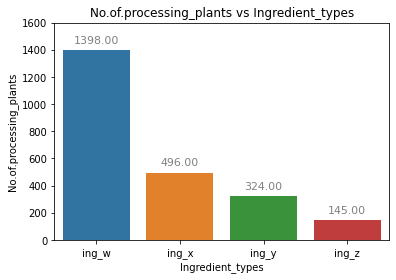

In [ ]:

ax = sns.barplot(x=x,y=y)
#ax.set_xticklabels(ax.get_xticklabels(),rotation=)
for p in ax.patches:
    ax.annotate("%.2f" % p.get_height(), (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', fontsize=11, color='gray', xytext=(0, 10),textcoords='offset points')

ax.set_xlabel("Ingredient_types")
ax.set_ylabel("No.of.processing_plants")
ax.set_title("No.of.processing_plants vs Ingredient_types")
plt.ylim(0, 1600)
plt.show()

### Insight2

*   How much percentage of yield is occupied by differnt ingredients



In [ ]:
per_ing=train_data[['ingredient_type','yield']].groupby(by='ingredient_type').sum()
per_ing['percentage']=per_ing['yield']/(per_ing['yield'].sum())

In [ ]:
per_ing

,yield,percentage
ingredient_type,,
ing_w,2.060313e+09,0.048138
ing_x,2.649007e+09,0.061893
ing_y,3.760286e+10,0.878573
ing_z,4.877499e+08,0.011396


In [ ]:
per_ing.reset_index(inplace=True)

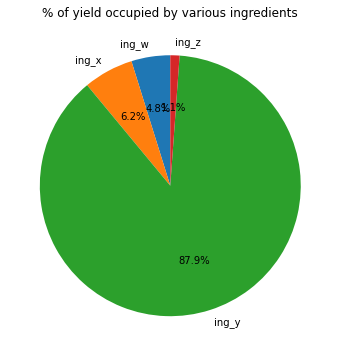

In [ ]:
fig, ax = plt.subplots(figsize=(8, 6))
ax.pie(per_ing['percentage'], labels=per_ing['ingredient_type'], autopct='%1.1f%%', startangle=90)
ax.set_title('% of yield occupied by various ingredients')

# show plot
plt.show()

### Insight3

*   percentage of yield occupied by various farming companies




In [ ]:
total_data.head()

,date,farm_id,ingredient_type,yield,deidentified_location,temp_obs,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed,farm_area,farming_company
0,2016-01-01 00:00:00,fid_110884,ing_w,0.0,location 7369,25.0,0.0,20.0,1019.7,0.0,0.0,690.455096,Obery Farms
1,2016-01-01 00:00:00,fid_90053,ing_w,0.0,location 7369,25.0,0.0,20.0,1019.7,0.0,0.0,252.696160,Obery Farms
2,2016-01-01 00:00:00,fid_17537,ing_w,0.0,location 7369,25.0,0.0,20.0,1019.7,0.0,0.0,499.446528,Obery Farms
3,2016-01-01 00:00:00,fid_110392,ing_w,0.0,location 7369,25.0,0.0,20.0,1019.7,0.0,0.0,2200.407555,Obery Farms
4,2016-01-01 00:00:00,fid_62402,ing_w,0.0,location 7369,25.0,0.0,20.0,1019.7,0.0,0.0,10833.140121,Obery Farms


In [ ]:
eda=total_data[['farming_company','yield']].groupby(by='farming_company',as_index=False)['yield'].sum()

In [ ]:
eda['yield%']=(eda['yield']/eda['yield'].sum())*100
eda.sort_values(by='yield%',inplace=True)
eda=eda.tail(4)

In [ ]:
eda

,farming_company,yield,yield%
0,Del Monte Foods,6.075534e+08,1.415153
11,Sanderson Farms,1.076545e+09,2.507558
14,Wayne Farms,2.318198e+09,5.399698
8,Obery Farms,3.743627e+10,87.198996


In [ ]:
100-eda['yield%'].sum()

3.478595106002615

In [ ]:
new={'farming_company':'Other_companies','yield':0,'yield%':3.478595106002615}
eda=eda.append(new,ignore_index=True)

In [ ]:
eda['yield%'].sum()

100.0

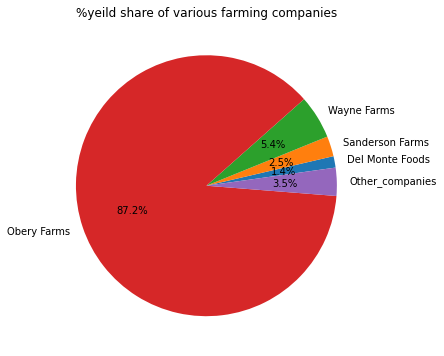

In [ ]:
fig, ax = plt.subplots(figsize=(8, 6))
ax.pie(eda['yield%'], labels=eda['farming_company'], autopct='%1.1f%%', startangle=8)
ax.set_title('%yeild share of various farming companies')

# show plot
plt.show()

### Insight4

*   Percentage of yield comming from various deidentified locations



In [ ]:
eda=total_data[['deidentified_location','yield']].groupby(by='deidentified_location',as_index=False)['yield'].sum()
eda['yield%']=(eda['yield']/eda['yield'].sum())*100
eda.sort_values(by='yield%',inplace=True)


In [ ]:
eda=eda.tail(4)


In [ ]:
100-(eda['yield%'].sum())

6.971137857751302

In [ ]:
new={'deidentified_location':'Other_locations','yield':0,'yield%':6.971137857751302}

In [ ]:
#f2 = {'Name': 'Amy', 'Maths': 89, 'Science': 93}
eda = eda.append(new, ignore_index = True)

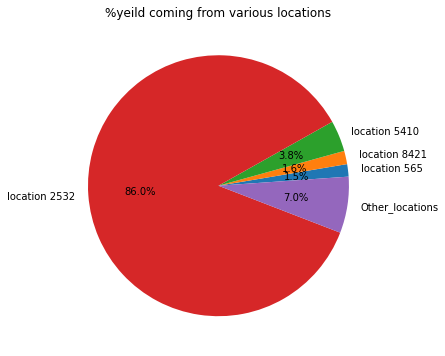

In [ ]:
fig, ax = plt.subplots(figsize=(8, 6))
ax.pie(eda['yield%'], labels=eda['deidentified_location'], autopct='%1.1f%%', startangle=4)
ax.set_title('%yeild coming from various locations')

# show plot
plt.show()

### Analyzing high and low yielded farms



1.   Converting date to datetime datatype and Extracting timestamp
2.   EDA 
    1. Analysis of Top Yeilded Farm
    2. Analysis of Low Yeilded Farm
    3. Analysis of ingredient types








In [ ]:
train_data.head()

,date,farm_id,ingredient_type,yield
0,2016-01-01 00:00:00,fid_110884,ing_w,0.0
1,2016-01-01 00:00:00,fid_90053,ing_w,0.0
2,2016-01-01 00:00:00,fid_17537,ing_w,0.0
3,2016-01-01 00:00:00,fid_110392,ing_w,0.0
4,2016-01-01 00:00:00,fid_62402,ing_w,0.0


In [ ]:
train_data.dtypes

date                object
farm_id             object
ingredient_type     object
yield              float64
dtype: object

In [ ]:
train_data.nunique()

date                  8784
farm_id               1434
ingredient_type          4
yield              1688175
dtype: int64

In [ ]:
##Extracting time stamp
#train_data['timestamp']=train_data['date'].apply(lambda x:x[11:19])

In [ ]:
#converting date into Datetime type
#date=np.array(train_data['date'],dtype='datetime64[h]')

In [ ]:
train_data['date']=pd.to_datetime(train_data['date'],format='%Y%m%d %H:%M:%S')

In [ ]:
train_data.dtypes

date               datetime64[ns]
farm_id                    object
ingredient_type            object
yield                     float64
dtype: object

In [ ]:
train_data.head()

,date,farm_id,ingredient_type,yield
0,2016-01-01,fid_110884,ing_w,0.0
1,2016-01-01,fid_90053,ing_w,0.0
2,2016-01-01,fid_17537,ing_w,0.0
3,2016-01-01,fid_110392,ing_w,0.0
4,2016-01-01,fid_62402,ing_w,0.0


In [ ]:
def minmaxdate(data,col_name):
  print('Min date in data:--',data[col_name].min())
  print('Max date in data:--',data[col_name].max())
minmaxdate(train_data,col_name='date')

Min date in data:-- 2016-01-01 00:00:00
Max date in data:-- 2016-12-31 23:00:00




*   Train Data Only Contain 1 Year of data




In [ ]:
train_data.describe(include='all')

<ipython-input-31-90d4f858b61d>:1: FutureWarning: Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.
  train_data.describe(include='all')


,date,farm_id,ingredient_type,yield
count,20216100,20216100,20216100,2.021610e+07
unique,8784,1434,4,NaN
top,2016-12-27 22:00:00,fid_63700,ing_w,NaN
freq,2370,51227,12060910,NaN
first,2016-01-01 00:00:00,NaN,NaN,NaN
last,2016-12-31 23:00:00,NaN,NaN,NaN
mean,NaN,NaN,NaN,2.117121e+03
std,NaN,NaN,NaN,1.532356e+05
min,NaN,NaN,NaN,0.000000e+00
25%,NaN,NaN,NaN,1.830000e+01


#### Finding high and low yielded farms

In [ ]:
##EDA
#1,TO know top and low crop yeild farms

In [ ]:
train_data.head()

,date,farm_id,ingredient_type,yield
0,2016-01-01,fid_110884,ing_w,0.0
1,2016-01-01,fid_90053,ing_w,0.0
2,2016-01-01,fid_17537,ing_w,0.0
3,2016-01-01,fid_110392,ing_w,0.0
4,2016-01-01,fid_62402,ing_w,0.0


In [ ]:
eda1=train_data.groupby(by='farm_id',as_index=False).sum()
eda1.head()

,farm_id,yield
0,fid_100053,4.722934e+05
1,fid_100107,5.786395e+07
2,fid_100135,2.196656e+05
3,fid_100249,1.574181e+05
4,fid_100303,5.318755e+05


In [ ]:
eda1.sort_values(by='yield',ascending=False,inplace=True,ignore_index=True)
eda1.head()

,farm_id,yield
0,fid_72059,3.350620e+10
1,fid_121183,4.404114e+08
2,fid_118955,4.286342e+08
3,fid_49646,3.904002e+08
4,fid_37988,3.142415e+08


In [ ]:
top5=eda1.head(5)
low5=eda1.tail(5)

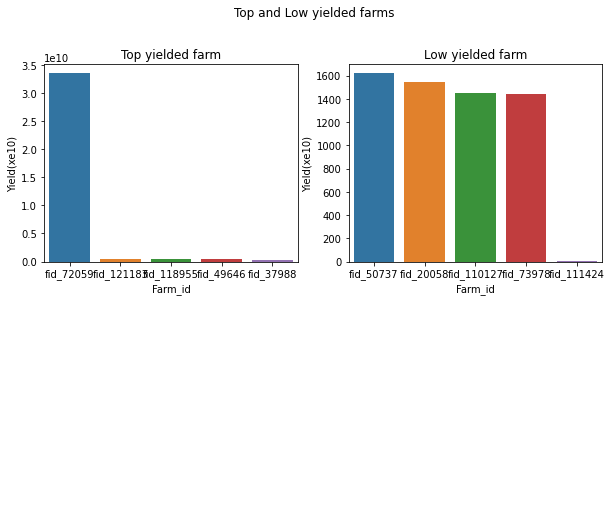

In [ ]:
fig, axes = plt.subplots(2,2, figsize=(10, 8))
fig.suptitle('Top and Low yielded farms')
ax1=sns.barplot(ax=axes[0, 0],data=top5,x=top5['farm_id'],y=top5['yield'])
ax1.set_xlabel("Farm_id")
ax1.set_ylabel("Yield(xe10)")
ax1.set_title('Top yielded farm')

ax1=sns.barplot(ax=axes[0, 1],data=low5,x=low5['farm_id'],y=low5['yield'])
ax1.set_xlabel("Farm_id")
ax1.set_ylabel("Yield(xe10)")
ax1.set_title('Low yielded farm')
axes[1,0].set_axis_off()
axes[1,1].set_axis_off()



*   Based on above plots
*   Top yielded field ---fid_72059
*   Low yielded field ---fid_111424






#### Analysis of Top Yielded Farm

In [ ]:
train_data.columns

Index(['date', 'farm_id', 'ingredient_type', 'yield'], dtype='object')

In [ ]:
train_data.nunique()

date                  8784
farm_id               1434
ingredient_type          4
yield              1688175
dtype: int64

In [ ]:
fid_72059=train_data[train_data['farm_id']=='fid_72059']

In [ ]:
fid_72059.head()

,date,farm_id,ingredient_type,yield
1533,2016-01-01 00:00:00,fid_72059,ing_w,282.248
1534,2016-01-01 00:00:00,fid_72059,ing_y,3241630.000
3829,2016-01-01 01:00:00,fid_72059,ing_w,282.248
3830,2016-01-01 01:00:00,fid_72059,ing_y,3241630.000
6125,2016-01-01 02:00:00,fid_72059,ing_w,284.864


In [ ]:
fid_72059.nunique()

date                8784
farm_id                1
ingredient_type        2
yield              12653
dtype: int64

In [ ]:
fid_72059.set_index('date',inplace=True)

In [ ]:
#single_day=fid_72059['2016-01-01 00:00:00':'2016-01-01 23:00:00']

In [ ]:
fid_72059

,farm_id,ingredient_type,yield
date,,,
2016-01-01 00:00:00,fid_72059,ing_w,282.248
2016-01-01 00:00:00,fid_72059,ing_y,3241630.000
2016-01-01 01:00:00,fid_72059,ing_w,282.248
2016-01-01 01:00:00,fid_72059,ing_y,3241630.000
2016-01-01 02:00:00,fid_72059,ing_w,284.864
...,...,...,...
2016-12-31 21:00:00,fid_72059,ing_y,4800.000
2016-12-31 22:00:00,fid_72059,ing_w,266.022
2016-12-31 22:00:00,fid_72059,ing_y,4896.000


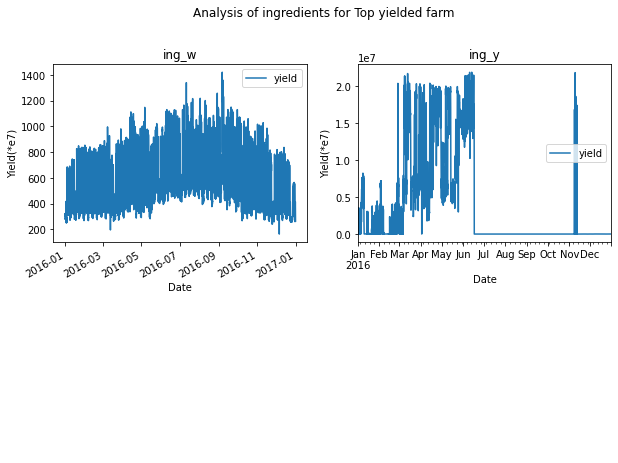

In [ ]:
fig, axes = plt.subplots(2,2, figsize=(10, 8))
fig.suptitle('Analysis of ingredients for Top yielded farm')
ax1=fid_72059[fid_72059['ingredient_type']=='ing_w'].plot(ax=axes[0,0])
ax1.set_xlabel("Date")
ax1.set_ylabel("Yield(*e7)")
ax1.set_title('ing_w')


ax1=fid_72059[fid_72059['ingredient_type']=='ing_y'].plot(ax=axes[0,1])
ax1.set_xlabel("Date")
ax1.set_ylabel("Yield(*e7)")
ax1.set_title('ing_y')
axes[1,0].set_axis_off()
axes[1,1].set_axis_off()

#### Analysis of Low Yielded Field

In [ ]:
fid_111424=train_data[train_data['farm_id']=='fid_111424']

In [ ]:
fid_111424

,date,farm_id,ingredient_type,yield
888,2016-01-01 00:00:00,fid_111424,ing_w,0.0002
3187,2016-01-01 01:00:00,fid_111424,ing_w,0.0004
5482,2016-01-01 02:00:00,fid_111424,ing_w,0.0004
7780,2016-01-01 03:00:00,fid_111424,ing_w,0.0004
10075,2016-01-01 04:00:00,fid_111424,ing_w,0.0004
...,...,...,...,...
20205199,2016-12-31 19:00:00,fid_111424,ing_w,0.0004
20207562,2016-12-31 20:00:00,fid_111424,ing_w,0.0004
20209927,2016-12-31 21:00:00,fid_111424,ing_w,0.0004
20212293,2016-12-31 22:00:00,fid_111424,ing_w,0.0004


In [ ]:
fid_111424.nunique()

date               8784
farm_id               1
ingredient_type       1
yield                 2
dtype: int64

In [ ]:
fid_111424.set_index('date',inplace=True)

Text(0.5, 1.0, 'Analysis of ingredients for Top yielded farm(only ing_w)')

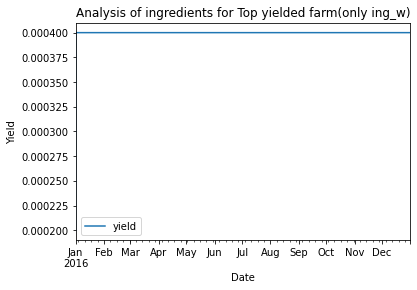

In [ ]:
#fig, axes = plt.subplots(1,1, figsize=(10, 8))
#fig.suptitle('Analysis of ingredients for Low yielded farm')
#ax1=sns.barplot(ax=axes[0, 0],data=top5,x=top5['farm_id'],y=top5['yield'])
ax1=fid_111424[fid_111424['ingredient_type']=='ing_w'].plot()
ax1.set_xlabel("Date")
ax1.set_ylabel("Yield")
ax1.set_title('Analysis of ingredients for Top yielded farm(only ing_w)')

#### Analysis of ingredient types 

In [ ]:
eda2=train_data.copy()
eda2.head()

,date,farm_id,ingredient_type,yield
0,2016-01-01,fid_110884,ing_w,0.0
1,2016-01-01,fid_90053,ing_w,0.0
2,2016-01-01,fid_17537,ing_w,0.0
3,2016-01-01,fid_110392,ing_w,0.0
4,2016-01-01,fid_62402,ing_w,0.0


In [ ]:
new=eda2[['date','ingredient_type','yield']]

In [ ]:
new.head()

,date,ingredient_type,yield
0,2016-01-01,ing_w,0.0
1,2016-01-01,ing_w,0.0
2,2016-01-01,ing_w,0.0
3,2016-01-01,ing_w,0.0
4,2016-01-01,ing_w,0.0


In [ ]:
eda2=new.groupby(by=['ingredient_type','date'],as_index=False).sum()
eda2.head()

,ingredient_type,date,yield
0,ing_w,2016-01-01 00:00:00,146796.9708
1,ing_w,2016-01-01 01:00:00,166439.5826
2,ing_w,2016-01-01 02:00:00,166652.5184
3,ing_w,2016-01-01 03:00:00,166988.5308
4,ing_w,2016-01-01 04:00:00,167381.4970


In [ ]:
eda2_pivot=eda2.pivot(index='date',columns='ingredient_type',values='yield')

In [ ]:
eda2_pivot.head()

ingredient_type,ing_w,ing_x,ing_y,ing_z
date,,,,
2016-01-01 00:00:00,146796.9708,52396.5669,3.924435e+06,87655.1681
2016-01-01 01:00:00,166439.5826,59582.4064,3.964789e+06,60670.8718
2016-01-01 02:00:00,166652.5184,58646.9936,9.660917e+05,68204.1314
2016-01-01 03:00:00,166988.5308,55827.6281,7.249452e+05,61265.7329
2016-01-01 04:00:00,167381.4970,53843.3643,8.847084e+05,64722.2291


In [ ]:
print(eda2_pivot.columns)
eda2_pivot.columns.name=None

Index(['ing_w', 'ing_x', 'ing_y', 'ing_z'], dtype='object', name='ingredient_type')


In [ ]:
eda2_pivot.head()

,ing_w,ing_x,ing_y,ing_z
date,,,,
2016-01-01 00:00:00,146796.9708,52396.5669,3.924435e+06,87655.1681
2016-01-01 01:00:00,166439.5826,59582.4064,3.964789e+06,60670.8718
2016-01-01 02:00:00,166652.5184,58646.9936,9.660917e+05,68204.1314
2016-01-01 03:00:00,166988.5308,55827.6281,7.249452e+05,61265.7329
2016-01-01 04:00:00,167381.4970,53843.3643,8.847084e+05,64722.2291


In [ ]:
eda2_pivot['Total']=eda2_pivot['ing_w']+eda2_pivot['ing_x']+eda2_pivot['ing_y']+eda2_pivot['ing_z']
eda2_pivot.head()

,ing_w,ing_x,ing_y,ing_z,Total
date,,,,,
2016-01-01 00:00:00,146796.9708,52396.5669,3.924435e+06,87655.1681,4.211284e+06
2016-01-01 01:00:00,166439.5826,59582.4064,3.964789e+06,60670.8718,4.251482e+06
2016-01-01 02:00:00,166652.5184,58646.9936,9.660917e+05,68204.1314,1.259595e+06
2016-01-01 03:00:00,166988.5308,55827.6281,7.249452e+05,61265.7329,1.009027e+06
2016-01-01 04:00:00,167381.4970,53843.3643,8.847084e+05,64722.2291,1.170655e+06


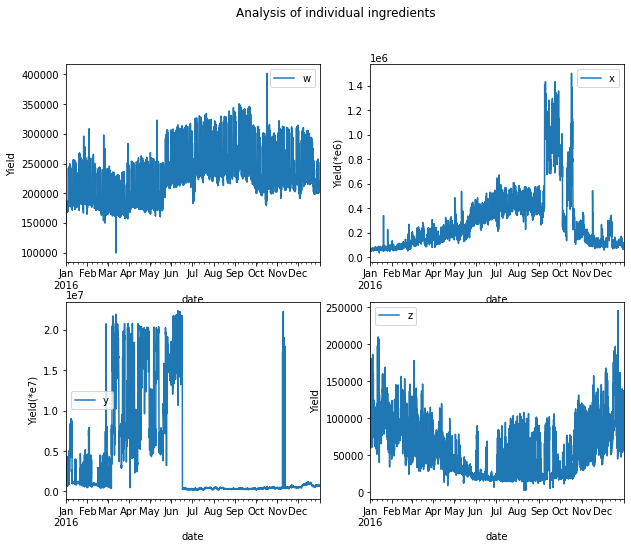

In [ ]:
fig, axes = plt.subplots(2,2, figsize=(10, 8))
fig.suptitle('Analysis of individual ingredients')
#For ing_w
ax1=eda2_pivot['ing_w'].plot(ax=axes[0,0])
#ax1.set_xlabel("Date")
ax1.set_ylabel("Yield")
ax1.legend("w")

#For ing_x
ax1=eda2_pivot['ing_x'].plot(ax=axes[0,1])
#ax1.set_xlabel("Date")
ax1.set_ylabel("Yield(*e6)")
#ax1.set_title('')
ax1.legend("x")

#For ing_y
ax1=eda2_pivot['ing_y'].plot(ax=axes[1,0])
#ax1.set_xlabel("Date")
ax1.set_ylabel("Yield(*e7)")
#ax1.set_title('ing_y')
ax1.legend("y")

#For ing_z
ax1=eda2_pivot['ing_z'].plot(ax=axes[1,1])
#ax1.set_xlabel("Date")
ax1.set_ylabel("Yield")
#ax1.set_title('ing_z')
ax1.legend("z")

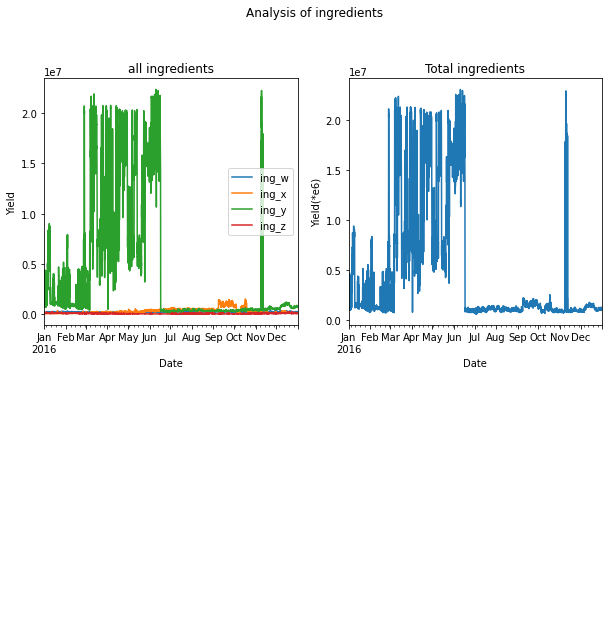

In [ ]:
fig, axes = plt.subplots(2,2, figsize=(10, 8))
fig.suptitle('Analysis of ingredients')
#For ing_w
ax1=eda2_pivot.drop('Total',axis=1).plot(ax=axes[0,0],figsize=(10, 10))
ax1.set_xlabel("Date")
ax1.set_ylabel("Yield")
ax1.set_title("all ingredients")

#For ing_x
ax1=eda2_pivot['Total'].plot(ax=axes[0,1],figsize=(10, 10))
ax1.set_xlabel("Date")
ax1.set_ylabel("Yield(*e6)")
ax1.set_title('Total ingredients')
axes[1,0].set_axis_off()
axes[1,1].set_axis_off()


## Merging the data



#### Merging train data

In [ ]:
train_data.head()

,date,farm_id,ingredient_type,yield
0,2016-01-01 00:00:00,fid_110884,ing_w,0.0
1,2016-01-01 00:00:00,fid_90053,ing_w,0.0
2,2016-01-01 00:00:00,fid_17537,ing_w,0.0
3,2016-01-01 00:00:00,fid_110392,ing_w,0.0
4,2016-01-01 00:00:00,fid_62402,ing_w,0.0


In [ ]:
train_data.shape

(20216100, 4)

In [ ]:
train_data.isnull().sum()

date               0
farm_id            0
ingredient_type    0
yield              0
dtype: int64



*   Train weather handling



In [ ]:
train_weather.head()

,timestamp,deidentified_location,temp_obs,cloudiness,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed
0,2016-01-01 00:00:00,location 7369,25.0,6.0,0.0,20.0,1019.7,NaN,0.0
1,2016-01-01 01:00:00,location 7369,24.4,NaN,70.0,21.1,1020.2,-1.0,1.5
2,2016-01-01 02:00:00,location 7369,22.8,2.0,0.0,21.1,1020.2,0.0,0.0
3,2016-01-01 03:00:00,location 7369,21.1,2.0,0.0,20.6,1020.1,0.0,0.0
4,2016-01-01 04:00:00,location 7369,20.0,2.0,250.0,20.0,1020.0,-1.0,2.6


In [ ]:
train_weather.shape

(139773, 9)

In [ ]:
train_weather.isnull().sum()

timestamp                    0
deidentified_location        0
temp_obs                    55
cloudiness               69173
wind_direction            6268
dew_temp                   113
pressure_sea_level       10618
precipitation            50289
wind_speed                 304
dtype: int64

In [ ]:
train_weather.drop('cloudiness',axis=1,inplace=True)
##because greaterthan 50 % null vals are there

In [ ]:
train_weather.rename(columns={'timestamp':'date'},inplace=True)

In [ ]:
train_weather['date']=pd.to_datetime(train_weather['date'])

In [ ]:
train_weather.dtypes

date                     datetime64[ns]
deidentified_location            object
temp_obs                        float64
wind_direction                  float64
dew_temp                        float64
pressure_sea_level              float64
precipitation                   float64
wind_speed                      float64
dtype: object

In [ ]:
train_weather.set_index('date',inplace=True)

In [ ]:
train_weather.dtypes

deidentified_location     object
temp_obs                 float64
wind_direction           float64
dew_temp                 float64
pressure_sea_level       float64
precipitation            float64
wind_speed               float64
dtype: object

In [ ]:
train_weather.interpolate(method='time',inplace=True)

In [ ]:
train_weather.isnull().sum()

deidentified_location    0
temp_obs                 0
wind_direction           0
dew_temp                 0
pressure_sea_level       0
precipitation            1
wind_speed               0
dtype: int64

<AxesSubplot:xlabel='date'>

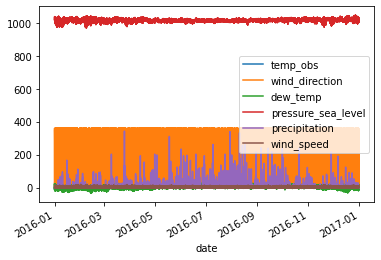

In [ ]:
train_weather.plot()

In [ ]:
train_weather.reset_index(inplace=True)

In [ ]:
train_weather.fillna(0,inplace=True)

<AxesSubplot:>

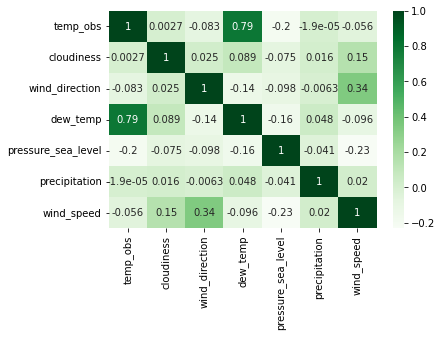

In [ ]:
sns.heatmap(train_weather.corr(),annot=True,cmap='Greens')

In [ ]:
train_weather['date']=pd.to_datetime(train_weather['date'],format='%Y%m%d %H:%M:%S')

In [ ]:
train_weather.dtypes

date                     datetime64[ns]
deidentified_location            object
temp_obs                        float64
cloudiness                      float64
wind_direction                  float64
dew_temp                        float64
pressure_sea_level              float64
precipitation                   float64
wind_speed                      float64
dtype: object

In [ ]:
#minmaxdate(train_weather,'timestamp')

In [ ]:
train_weather.describe()

,temp_obs,cloudiness,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed
count,139718.000000,70600.000000,133505.000000,139660.000000,129155.000000,89484.000000,139469.000000
mean,14.418106,2.149306,180.526632,7.350158,1016.158038,0.983047,3.560527
std,10.626595,2.599150,111.523629,9.790235,7.629684,8.463678,2.335874
min,-28.900000,0.000000,0.000000,-35.000000,968.200000,-1.000000,0.000000
25%,7.200000,0.000000,80.000000,0.600000,1011.800000,0.000000,2.100000
50%,15.000000,2.000000,190.000000,8.300000,1016.400000,0.000000,3.100000
75%,22.200000,4.000000,280.000000,14.400000,1020.800000,0.000000,5.000000
max,47.200000,9.000000,360.000000,26.100000,1045.500000,343.000000,19.000000




*   Farm data



In [ ]:
farm_data.head()

,farm_id,operations_commencing_year,num_processing_plants,farm_area,farming_company,deidentified_location
0,fid_110884,2008.0,NaN,690.455096,Obery Farms,location 7369
1,fid_90053,2004.0,NaN,252.696160,Obery Farms,location 7369
2,fid_17537,1991.0,NaN,499.446528,Obery Farms,location 7369
3,fid_110392,2002.0,NaN,2200.407555,Obery Farms,location 7369
4,fid_62402,1975.0,NaN,10833.140121,Obery Farms,location 7369


In [ ]:
farm_data.shape

(1449, 6)

In [ ]:
farm_data.isnull().sum()

farm_id                          0
operations_commencing_year     774
num_processing_plants         1094
farm_area                        0
farming_company                  0
deidentified_location            0
dtype: int64

In [ ]:
farm_data.drop(['operations_commencing_year','num_processing_plants'],axis=1,inplace=True)

In [ ]:
farm_data.shape

(1449, 4)

In [ ]:
farm_data.nunique()

farm_id                  1434
farm_area                1397
farming_company            16
deidentified_location      16
dtype: int64

In [ ]:
train_weather.shape

(139773, 8)

In [ ]:
train_weather.columns

Index(['date', 'deidentified_location', 'temp_obs', 'wind_direction',
       'dew_temp', 'pressure_sea_level', 'precipitation', 'wind_speed'],
      dtype='object')

In [ ]:
farm_data.shape

(1449, 4)

In [ ]:
farmwea=train_weather.merge(farm_data,on='deidentified_location')
farmwea.shape

(12676166, 11)

In [ ]:
farmwea.columns

Index(['date', 'deidentified_location', 'temp_obs', 'wind_direction',
       'dew_temp', 'pressure_sea_level', 'precipitation', 'wind_speed',
       'farm_id', 'farm_area', 'farming_company'],
      dtype='object')

In [ ]:
train_data['date']=pd.to_datetime(train_data['date'])

In [ ]:
total_data=train_data.merge(farmwea,on=['farm_id','date'])

In [ ]:
total_data.shape

(20511532, 13)

In [ ]:
#total_data.to_csv("/content/drive/MyDrive/Final_capstone/total_data.csv",index=False)

### Merging test data


In [7]:
test_data=pd.read_csv("/content/drive/MyDrive/Final_capstone/test_data/test_data-1664552867678.csv")

In [8]:
test_data.shape

(20848800, 4)

In [9]:
test_data.isnull().sum()

date               0
farm_id            0
ingredient_type    0
id                 0
dtype: int64

In [26]:
test_data['date']=pd.to_datetime(test_data['date'])

In [34]:
test_weather=pd.read_csv("/content/drive/MyDrive/Final_capstone/test_data/test_weather-1646897984996-1664552604982.csv")

In [35]:
test_weather.isnull().sum()

timestamp                    0
deidentified_location        0
temp_obs                    43
cloudiness               69065
wind_direction            6134
dew_temp                   184
pressure_sea_level       10883
precipitation            47788
wind_speed                 240
dtype: int64

In [36]:
test_weather.drop('cloudiness',axis=1,inplace=True)

In [37]:
test_weather.rename(columns={'timestamp':'date'},inplace=True)

In [38]:
test_weather['date']=pd.to_datetime(test_weather['date'])

In [39]:
test_weather.set_index('date',inplace=True)

In [40]:
test_weather.interpolate(method='time',inplace=True)

In [44]:
test_weather.reset_index(inplace=True)

In [45]:
test_weather.isnull().sum()

date                     0
deidentified_location    0
temp_obs                 0
wind_direction           0
dew_temp                 0
pressure_sea_level       0
precipitation            1
wind_speed               0
dtype: int64

In [46]:
test_weather.fillna(0,inplace=True)

In [47]:
farm_data.head()

,farm_id,operations_commencing_year,num_processing_plants,farm_area,farming_company,deidentified_location
0,fid_110884,2008.0,NaN,690.455096,Obery Farms,location 7369
1,fid_90053,2004.0,NaN,252.696160,Obery Farms,location 7369
2,fid_17537,1991.0,NaN,499.446528,Obery Farms,location 7369
3,fid_110392,2002.0,NaN,2200.407555,Obery Farms,location 7369
4,fid_62402,1975.0,NaN,10833.140121,Obery Farms,location 7369


In [48]:
farm_data1=farm_data.copy()

In [49]:
farm_data1.drop(['num_processing_plants','operations_commencing_year'],axis=1,inplace=True)

In [50]:
weafarm=test_weather.merge(farm_data1,on=['deidentified_location'])

In [51]:
weafarm.isnull().sum()

date                     0
deidentified_location    0
temp_obs                 0
wind_direction           0
dew_temp                 0
pressure_sea_level       0
precipitation            0
wind_speed               0
farm_id                  0
farm_area                0
farming_company          0
dtype: int64

In [53]:
test_merged=test_data.merge(weafarm,on=['date','farm_id'])

In [60]:
test_merged.to_csv("/content/drive/MyDrive/Final_capstone/test_data/test_merged.csv",index=False)

In [59]:
test_merged.shape

(21154797, 13)

In [55]:
#ingw
ingw=len(test_merged[test_merged['ingredient_type']=='ing_w']['farm_id'].value_counts().to_frame().reset_index())
#ingx
ingx=len(test_merged[test_merged['ingredient_type']=='ing_x']['farm_id'].value_counts().to_frame().reset_index())
#ingy
ingy=len(test_merged[test_merged['ingredient_type']=='ing_y']['farm_id'].value_counts().to_frame().reset_index())
#ingz
ingz=len(test_merged[test_merged['ingredient_type']=='ing_z']['farm_id'].value_counts().to_frame().reset_index())

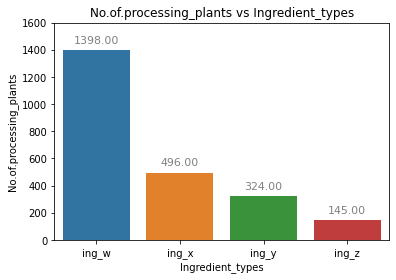

In [56]:
x=['ing_w','ing_x','ing_y','ing_z']
y=[ingw,ingx,ingy,ingz]
ax = sns.barplot(x=x,y=y)
#ax.set_xticklabels(ax.get_xticklabels(),rotation=)
for p in ax.patches:
    ax.annotate("%.2f" % p.get_height(), (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', fontsize=11, color='gray', xytext=(0, 10),textcoords='offset points')

ax.set_xlabel("Ingredient_types")
ax.set_ylabel("No.of.processing_plants")
ax.set_title("No.of.processing_plants vs Ingredient_types")
plt.ylim(0, 1600)
plt.show()

# **Univariate Analysis**

# Approach-1

*   Building univariate time series models for high yield farm



In [ ]:
data=train_data[train_data['farm_id']=='fid_72059']

In [ ]:
data.isnull().sum()

In [ ]:
data.nunique()

In [ ]:
data['date']=pd.to_datetime(data['date'],format='%Y%m%d %H:%M:%S')
data.dtypes

In [ ]:
data.set_index('date',inplace=True)
data=data[['ingredient_type','yield']]
data.head()

In [ ]:
data_pivot=data.pivot(columns='ingredient_type',values='yield')
data_pivot

In [ ]:
data_pivot.isnull().sum()


In [ ]:
data_pivot.interpolate(method='time',inplace=True)

In [ ]:
data_pivot.columns.name=None

In [ ]:
new_index=pd.date_range(start='2016-01-01 00:00:00',end='2016-12-31 23:00:00',freq='H')

In [ ]:
data_pivot1=data_pivot.reindex(new_index,fill_value=0)

In [ ]:
data_pivot1.isnull().sum()

In [ ]:
data_pivot1['ing_w'].plot(figsize=(25,7))

In [ ]:
data_pivot1['ing_y'].plot(figsize=(25,7))

In [ ]:
ing_w=data_pivot1[['ing_w']]
ing_w.head()

In [ ]:
31*24

In [ ]:
seasonal_decompose(ing_w,period=744).plot();

In [ ]:
#checking stationary
def adf(data):
  adf,pval,usedlag,nobs,cric_val,icbest=adfuller(data)
  if (pval<0.05):
    return 'stationary'
  else:
    return 'nonstationary'
adf(ing_w['ing_w'])

In [ ]:
def plots(data, lags=None):
    fig, axes = plt.subplots(2,2, figsize=(15, 8))
    fig.suptitle('Prediction Plots')
    #For data
    ax1=data.plot(ax=axes[0,0])
    #For train
    ax1=sm.tsa.graphics.plot_acf(data, lags=lags, zero=False,ax=axes[0,1])
    #For test
    ax1=sm.tsa.graphics.plot_pacf(data, lags=lags, zero = False,ax=axes[1,0])
    axes[1,1].set_axis_off()
  
    

In [ ]:
plots(ing_w)

In [ ]:
id1_train=ing_w['2016-01':'2016-10']
id1_test=ing_w['2016-11':'2016-12']

In [ ]:
id1_train

In [ ]:
id_train=id1_train.copy()
id_test=id1_test.copy()

In [ ]:
id_train

In [131]:
#ARMA Model

### ARMA

In [132]:
import statsmodels.api as sm


In [133]:
def arma_models(p,q,train,test):
  model = sm.tsa.ARMA(train, (p, q)).fit(trend='nc', disp=0)
  train['predictions']=model.predict(start='2016-01-01 00:00:00',end='2016-10-31 23:00:00')
  test['predictions']=model.predict(start='2016-11-01 00:00:00',end='2016-12-31 23:00:00')
  fig, axes = plt.subplots(2,2, figsize=(15, 8))
  fig.suptitle('Prediction Plots')
  #For data
  residuals=test['ing_w']-test['predictions']
  ax1=residuals.plot(kind='kde',ax=axes[0,0])
  ax1.set_title('Resid_plot')
  #For train
  ax1=train.plot(ax=axes[0,1])
  #For test
  ax1=test.plot(ax=axes[1,0])
  axes[1,1].set_axis_off()
  #performance
  print('Train RMSE:',np.sqrt(mse(train['ing_w'],train['predictions'])))
  print('Test RMSE:',np.sqrt(mse(test['ing_w'],test['predictions'])))

In [ ]:
arma_models(3,2,id_train,id_test)

In [ ]:
#SARIMAX Model

### SARIMAX

In [ ]:
id_train=id1_train.copy()
id_test=id1_test.copy()

In [ ]:
id_train

,ing_w
2016-01-01 00:00:00,282.248
2016-01-01 01:00:00,282.248
2016-01-01 02:00:00,284.864
2016-01-01 03:00:00,280.287
2016-01-01 04:00:00,279.975
...,...
2016-10-31 19:00:00,641.319
2016-10-31 20:00:00,610.620
2016-10-31 21:00:00,545.559
2016-10-31 22:00:00,463.929


In [ ]:
def sarima_models(p,d,q,s1,s2,s3,s4,train,test):
  model = sm.tsa.statespace.SARIMAX(id1_train, order=(p,d,q), seasonal_order=(s1,s2,s3,s4), trend='c').fit()
  train['predictions']=model.predict(start='2016-01-01 00:00:00',end='2016-10-31 23:00:00')
  test['predictions']=model.predict(start='2016-11-01 00:00:00',end='2016-12-31 23:00:00')
  model.plot_diagnostics(lags=12,figsize = (20,10),)
  fig, axes = plt.subplots(2,2, figsize=(15, 8))
  fig.suptitle('Prediction Plots')
  #For data
  residuals=test['ing_w']-test['predictions']
  ax1=residuals.plot(kind='kde',ax=axes[0,0])
  ax1.set_title('Resid_plot')
  #For train
  ax1=train.plot(ax=axes[0,1])
  #For test
  ax1=test.plot(ax=axes[1,0])
  axes[1,1].set_axis_off()
  #performance
  print('Train RMSE:',np.sqrt(mse(train['ing_w'],train['predictions'])))
  print('Test RMSE:',np.sqrt(mse(test['ing_w'],test['predictions'])))

Train RMSE: 43.88333679551119
Test RMSE: 1470776.7691647173


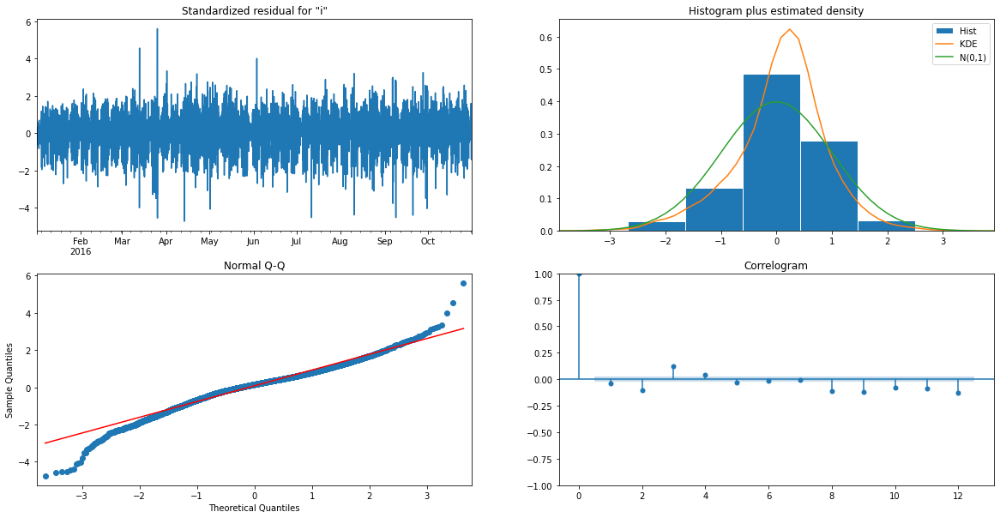

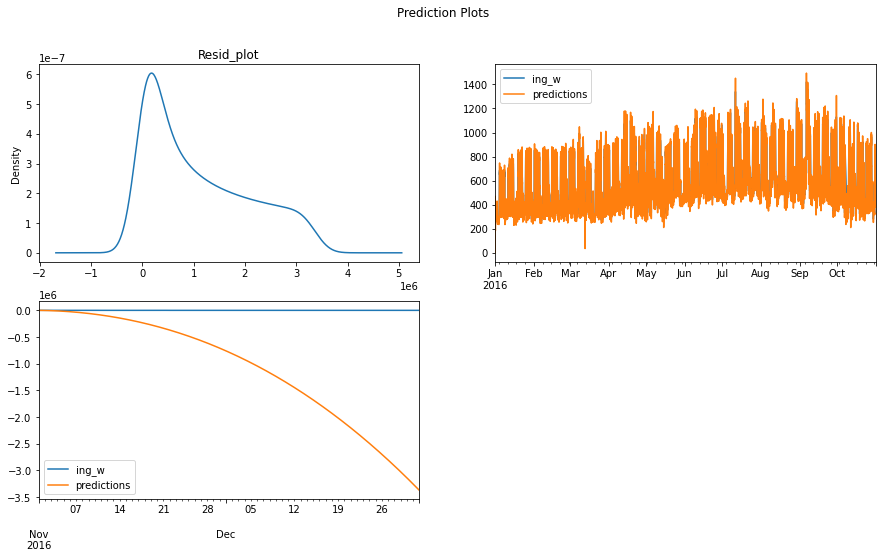

In [ ]:
sarima_models(3,2,3,0,1,1,4,id_train,id_test)

In [ ]:
#fb prophet model

### FB Prophet

In [ ]:
id_train=id1_train.copy()
id_test=id1_test.copy()

In [ ]:
id_train

In [ ]:
id_train.reset_index(inplace=True)

In [ ]:
id_test.reset_index(inplace=True)

In [ ]:
id_train.rename(columns={'index':'ds','ing_w':'y'},inplace=True)
id_test.rename(columns={'index':'ds','ing_w':'y'},inplace=True)

In [ ]:
id_train

In [ ]:
m = Prophet()
m.fit(id_train)


In [ ]:
id_test

In [ ]:
forecast_train=m.predict(id_train[['ds']])
forecast_train.head()


In [ ]:
id_train['yhat']=forecast_train['yhat']


In [ ]:
id_train.set_index('ds',inplace=True)

In [ ]:
id_train.plot(figsize=(15,8))

In [148]:
future=id_test[['ds']]
future.dtypes

ds    datetime64[ns]
dtype: object

In [149]:
forecast = m.predict(future)
print(forecast.columns)

Index(['ds', 'trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper',
       'additive_terms', 'additive_terms_lower', 'additive_terms_upper',
       'daily', 'daily_lower', 'daily_upper', 'weekly', 'weekly_lower',
       'weekly_upper', 'multiplicative_terms', 'multiplicative_terms_lower',
       'multiplicative_terms_upper', 'yhat'],
      dtype='object')


In [150]:
id_test['yhat']=forecast['yhat']

In [151]:
id_test.set_index('ds',inplace=True)

In [152]:
id_test

,y,yhat
ds,,
2016-11-01 00:00:00,403.316,462.124815
2016-11-01 01:00:00,396.439,440.862675
2016-11-01 02:00:00,388.837,429.964579
2016-11-01 03:00:00,382.315,424.267480
2016-11-01 04:00:00,373.147,420.988476
...,...,...
2016-12-31 19:00:00,299.058,267.416923
2016-12-31 20:00:00,302.477,218.405897
2016-12-31 21:00:00,269.963,170.632402


<AxesSubplot:xlabel='ds'>

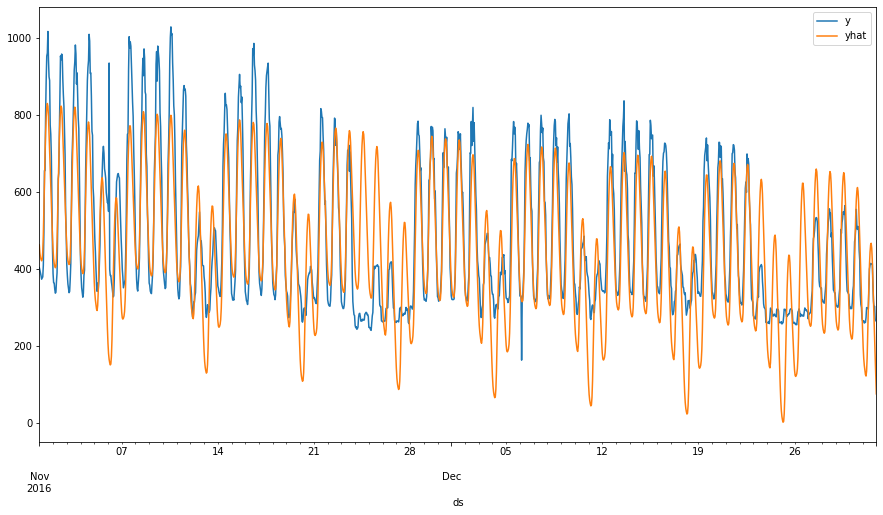

In [ ]:
id_test.plot(figsize=(15,8))

In [ ]:
#2017 forecast using FB Prophet

In [ ]:
ingw=ing_w.copy()


In [ ]:
ingw.reset_index(inplace=True)

In [ ]:
ingw.head()

,ds,y
0,2016-01-01 00:00:00,282.248
1,2016-01-01 01:00:00,282.248
2,2016-01-01 02:00:00,284.864
3,2016-01-01 03:00:00,280.287
4,2016-01-01 04:00:00,279.975


In [ ]:
ingw.rename(columns={'index':'ds','ing_w':'y'},inplace=True)

In [ ]:
future_date=pd.date_range(start='2017-01-01 00:00:00',end='2017-12-31 23:00:00',freq="H")

In [ ]:
future=pd.DataFrame(future_date,columns=['ds'])

In [ ]:
m = Prophet()
m.fit(ingw)

forecast=m.predict(future[['ds']])[['ds','yhat']]
forecast.head()


INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


,ds,yhat
0,2017-01-01 00:00:00,81.912578
1,2017-01-01 01:00:00,56.634136
2,2017-01-01 02:00:00,42.172850
3,2017-01-01 03:00:00,33.267048
4,2017-01-01 04:00:00,27.641794


In [ ]:
forecast.set_index('ds',inplace=True)

<AxesSubplot:xlabel='ds'>

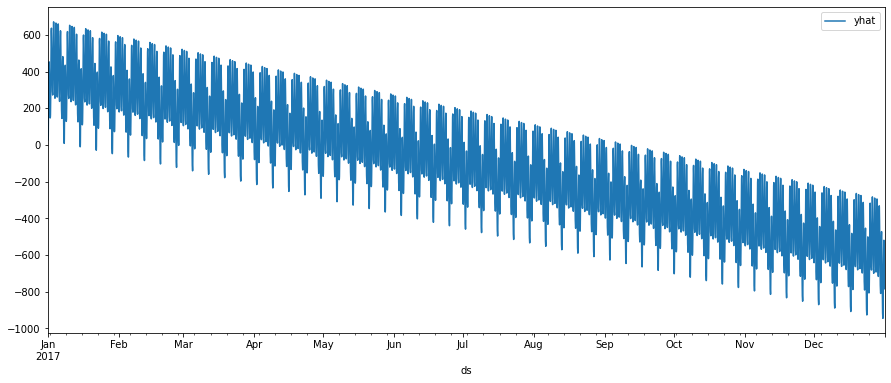

In [ ]:
forecast.plot(figsize=(15,6))

### LSTM

In [ ]:
ing_w.head()

,ing_w
2016-01-01 00:00:00,282.248
2016-01-01 01:00:00,282.248
2016-01-01 02:00:00,284.864
2016-01-01 03:00:00,280.287
2016-01-01 04:00:00,279.975


In [ ]:
ingw=ing_w['ing_w']

In [ ]:
ingw

2016-01-01 00:00:00    282.248
2016-01-01 01:00:00    282.248
2016-01-01 02:00:00    284.864
2016-01-01 03:00:00    280.287
2016-01-01 04:00:00    279.975
                        ...   
2016-12-31 19:00:00    299.058
2016-12-31 20:00:00    302.477
2016-12-31 21:00:00    269.963
2016-12-31 22:00:00    266.022
2016-12-31 23:00:00    263.689
Freq: H, Name: ing_w, Length: 8784, dtype: float64

In [ ]:
ingw.shape

(8784,)

In [ ]:
def df_to_X_y(df, window_size=365):
  df_as_np = df.to_numpy()
  X = []
  y = []
  for i in range(len(df_as_np)-window_size):
    row = [[a] for a in df_as_np[i:i+window_size]]
    X.append(row)
    label = df_as_np[i+window_size]
    y.append(label)
  return np.array(X), np.array(y)

In [ ]:
WINDOW_SIZE=365
X1, y1 = df_to_X_y(ingw, WINDOW_SIZE)
X1.shape, y1.shape

((8419, 365, 1), (8419,))

In [ ]:
X_train1, y_train1 = X1[:7000], y1[:7000]
X_val1, y_val1 = X1[7000:7500], y1[7000:7500]
X_test1, y_test1 = X1[7500:], y1[7500:]
X_train1.shape, y_train1.shape, X_val1.shape, y_val1.shape, X_test1.shape, y_test1.shape

((7000, 365, 1), (7000,), (500, 365, 1), (500,), (919, 365, 1), (919,))

In [ ]:
model1 = Sequential()
model1.add(InputLayer((365, 1)))
model1.add(LSTM(64))
model1.add(Dense(8, 'relu'))
model1.add(Dense(1, 'relu'))

model1.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_1 (LSTM)               (None, 64)                16896     
                                                                 
 dense_2 (Dense)             (None, 8)                 520       
                                                                 
 dense_3 (Dense)             (None, 1)                 9         
                                                                 
Total params: 17,425
Trainable params: 17,425
Non-trainable params: 0
_________________________________________________________________


In [ ]:
cp1 = ModelCheckpoint('model1/', save_best_only=True)
model1.compile(loss=MeanSquaredError(), optimizer=Adam(learning_rate=0.0001), metrics=[RootMeanSquaredError()])

In [ ]:
model1.fit(X_train1, y_train1, validation_data=(X_val1, y_val1), epochs=10, callbacks=[cp1])

Epoch 1/10
216/219 [============================>.] - ETA: 0s - loss: 412246.1875 - root_mean_squared_error: 642.0640

219/219 [==============================] - 11s 34ms/step - loss: 412365.0938 - root_mean_squared_error: 642.1566 - val_loss: 351237.7500 - val_root_mean_squared_error: 592.6531
Epoch 2/10
219/219 [==============================] - 4s 18ms/step - loss: 412365.1562 - root_mean_squared_error: 642.1566 - val_loss: 351237.7500 - val_root_mean_squared_error: 592.6531
Epoch 3/10
219/219 [==============================] - 3s 16ms/step - loss: 412365.1875 - root_mean_squared_error: 642.1567 - val_loss: 351237.7500 - val_root_mean_squared_error: 592.6531
Epoch 4/10
219/219 [==============================] - 3s 14ms/step - loss: 412365.2500 - root_mean_squared_error: 642.1567 - val_loss: 351237.7500 - val_root_mean_squared_error: 592.6531
Epoch 5/10
219/219 [==============================] - 3s 14ms/step - loss: 412365.1875 - root_mean_squared_error: 642.1567 - val_loss: 351237.7500 - val_root_mean_squared_error: 592.6531
Epoch 6/10
219/219 [==============================] - 4s 18ms/step - loss: 

In [ ]:
from tensorflow.keras.models import load_model
model1 = load_model('model1/')

In [ ]:
train_predictions = model1.predict(X_train1).flatten()
train_results = pd.DataFrame(data={'Train Predictions':train_predictions, 'Actuals':y_train1})
train_results

219/219 [==============================] - 2s 7ms/step


,Train Predictions,Actuals
0,0.0,283.234
1,0.0,287.805
2,0.0,291.718
3,0.0,291.752
4,0.0,310.203
...,...,...
6995,0.0,954.989
6996,0.0,894.432
6997,0.0,852.906
6998,0.0,822.720


<AxesSubplot:>

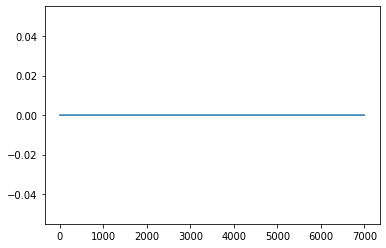

In [ ]:
train_results['Train Predictions'].plot()

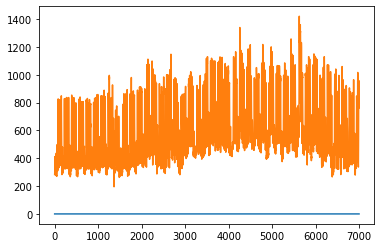

In [ ]:

plt.plot(train_results['Train Predictions'])
plt.plot(train_results['Actuals'])

# Approach-2





## Extracting Farm_ids

In [ ]:
def farm_id_extract(data):
  farm_id=data['farm_id'].value_counts().to_frame()
  farm_id.reset_index(inplace=True)
  list=farm_id['index'].to_list()
  print(len(list))
  return list


In [ ]:
farms=farm_id_extract(train_data)

1434


In [ ]:
farms1=farms[0:700]
farms2=farms[700:]

## Making DataFrames for stationary and non Stationary

In [ ]:
def adf(data):
  adf,pval,usedlag,nobs,cric_val,icbest=adfuller(data)
  if (pval<0.05):
    return 'stationary'
  else:
    return 'nonstationary'


In [ ]:
def stat_ns(data,farm_ids):
  ing_w_st=[]
  ing_x_st=[]
  ing_y_st=[]
  ing_z_st=[]
  ing_w_ns=[]
  ing_x_ns=[]
  ing_y_ns=[]
  ing_z_ns=[]
  s=0
  for farm in farm_ids:
    s=s+1
    id1=data[data['farm_id']==farm]
    id1_s1=id1.groupby(by=['date','ingredient_type'],as_index=False).agg('sum')
    id1_pivot=id1_s1.pivot(index='date',columns='ingredient_type',values='yield')
    id1_pivot.columns.name=None
    cols=id1_pivot.columns.to_list()
    if 'ing_w' in cols:
      print("status(running_id):",s)
      id1_pivot['ing_w'].fillna(0,inplace=True)
      if(adf(id1_pivot['ing_w'])=='stationary'):
        ing_w_st.append(farm)
      else:
        ing_w_ns.append(farm)
    if 'ing_x' in cols:
      id1_pivot['ing_x'].fillna(0,inplace=True)
      if(adf(id1_pivot['ing_x'])=='stationary'):
        ing_x_st.append(farm)
      else:
        ing_x_ns.append(farm)
    if 'ing_y' in cols:
      id1_pivot['ing_y'].fillna(0,inplace=True)
      if(adf(id1_pivot['ing_y'])=='stationary'):
        ing_y_st.append(farm)
      else:
        ing_y_ns.append(farm)
    if 'ing_z' in cols:
      id1_pivot['ing_z'].fillna(0,inplace=True)
      if(adf(id1_pivot['ing_z'])=='stationary'):
        ing_z_st.append(farm)
      else:
        ing_z_ns.append(farm)
      
  #st_ns=pd.DataFrame()
  #st_ns['ing_w_st']=ing_w_st
  #st_ns['ing_w_ns']=ing_w_ns
  #st_ns['ing_x_st']=ing_x_st
  #st_ns['ing_x_ns']=ing_x_ns
  #st_ns['ing_y_st']=ing_y_st
  #st_ns['ing_y_ns']=ing_y_ns
  #st_ns['ing_z_st']=ing_z_st
  #st_ns['ing_z_ns']=ing_z_ns
  #print('No.of.ids:',len(ing_w_st)+len(ing_w_ns)+len(ing_x_st)+len(ing_x_ns)+len(ing_y_st)+len(ing_y_ns)+len(ing_z_st)+len(ing_z_ns)) 
  #d={'ing_w_st'}
  return ing_w_st,ing_w_ns,ing_x_st,ing_x_ns,ing_y_st,ing_y_ns,ing_z_st,ing_z_ns

In [ ]:
ing_w_st1,ing_w_ns1,ing_x_st1,ing_x_ns1,ing_y_st1,ing_y_ns1,ing_z_st1,ing_z_ns1=st_ns_data=stat_ns(train_data,farms1)

In [ ]:
def make_same_lenlist(list,max_size):
  if(len(list)!=max_size):
    a=max_size-len(list)
    for i in range(0,a):
      list.append('NA')
  return list


In [ ]:
set1=pd.DataFrame({'ing_w_st':make_same_lenlist(ing_w_st1,700),'ing_w_ns':make_same_lenlist(ing_w_ns1,700),'ing_x_st':make_same_lenlist(ing_x_st1,700),'ing_x_ns':make_same_lenlist(ing_x_ns1,700),'ing_y_st':make_same_lenlist(ing_y_st1,700),'ing_y_ns':make_same_lenlist(ing_y_ns1,700),'ing_z_st':make_same_lenlist(ing_z_st1,700),'ing_z_ns':make_same_lenlist(ing_z_ns1,700)})

In [ ]:
set1.to_csv('/content/drive/MyDrive/Final_capstone/train_data/st_ns_set1.csv',index=False)

In [ ]:
ing_w_st2,ing_w_ns2,ing_x_st2,ing_x_ns2,ing_y_st2,ing_y_ns2,ing_z_st2,ing_z_ns2=st_ns_data=stat_ns(train_data,farms2)

In [ ]:
set2=pd.DataFrame({'ing_w_st':make_same_lenlist(ing_w_st2,734),'ing_w_ns':make_same_lenlist(ing_w_ns2,734),'ing_x_st':make_same_lenlist(ing_x_st2,734),'ing_x_ns':make_same_lenlist(ing_x_ns2,734),'ing_y_st':make_same_lenlist(ing_y_st2,734),'ing_y_ns':make_same_lenlist(ing_y_ns2,734),'ing_z_st':make_same_lenlist(ing_z_st2,734),'ing_z_ns':make_same_lenlist(ing_z_ns2,734)})

In [ ]:
set2.to_csv('/content/drive/MyDrive/Final_capstone/train_data/st_ns_set2.csv',index=False)

## Fixing models and params

In [ ]:
na=['NA']
set1=pd.read_csv("/content/drive/MyDrive/Final_capstone/train_data/st_ns_set1.csv",na_values=na)
set1.head()

,ing_w_st,ing_w_ns,ing_x_st,ing_x_ns,ing_y_st,ing_y_ns,ing_z_st,ing_z_ns
0,fid_63700,fid_82299,fid_63700,fid_40569,fid_63700,fid_122174,fid_63700,fid_48766
1,fid_68761,fid_23693,fid_68761,fid_91594,fid_103446,fid_46342,fid_68761,fid_33276
2,fid_103446,fid_91594,fid_103446,fid_27582,fid_109814,fid_27773,fid_103446,fid_99942
3,fid_109814,fid_102220,fid_109814,fid_94240,fid_117459,fid_54695,fid_109814,fid_69285
4,fid_122174,fid_40785,fid_122174,fid_35661,fid_47796,fid_118135,fid_73431,fid_25582


In [ ]:
set2=pd.read_csv("/content/drive/MyDrive/Final_capstone/train_data/st_ns_set2.csv",na_values=na)
set2.head()

,ing_w_st,ing_w_ns,ing_x_st,ing_x_ns,ing_y_st,ing_y_ns,ing_z_st,ing_z_ns
0,fid_71616,fid_107436,fid_98608,NaN,fid_75161,fid_20282,NaN,NaN
1,fid_23619,fid_107874,fid_24451,NaN,fid_40374,fid_115504,NaN,NaN
2,fid_100807,fid_12360,fid_109189,NaN,fid_51284,fid_60652,NaN,NaN
3,fid_91133,fid_105593,fid_39966,NaN,fid_93390,NaN,NaN,NaN
4,fid_64441,fid_76042,fid_115974,NaN,fid_31488,NaN,NaN,NaN


In [ ]:
sets=pd.concat([set1,set2],axis=0)
sets.head()

,ing_w_st,ing_w_ns,ing_x_st,ing_x_ns,ing_y_st,ing_y_ns,ing_z_st,ing_z_ns
0,fid_63700,fid_82299,fid_63700,fid_40569,fid_63700,fid_122174,fid_63700,fid_48766
1,fid_68761,fid_23693,fid_68761,fid_91594,fid_103446,fid_46342,fid_68761,fid_33276
2,fid_103446,fid_91594,fid_103446,fid_27582,fid_109814,fid_27773,fid_103446,fid_99942
3,fid_109814,fid_102220,fid_109814,fid_94240,fid_117459,fid_54695,fid_109814,fid_69285
4,fid_122174,fid_40785,fid_122174,fid_35661,fid_47796,fid_118135,fid_73431,fid_25582


In [ ]:
ing_z_st_list=sets['ing_z_ns'].value_counts().to_frame().reset_index()['index'].to_list()



*   ARMA



In [ ]:

df=pd.DataFrame({'Model_Name':[],'Farm_id':[],'Params_p':[],'Params_q':[],'Train_error':[],'Test_error':[]})
for i in range(0,4):
  df1=pd.DataFrame({'Model_Name':[],'Farm_id':[],'Params_p':[],'Params_q':[],'Train_error':[],'Test_error':[]})
  fid=random.choices(ing_z_st_list, k=1)
  fid=fid[0]
  data1=train_data[(train_data['farm_id']==fid)&(train_data['ingredient_type']=='ing_z')]
  data1=data1.groupby(by=['date','ingredient_type'],as_index=False).sum()
  data1_pivot=data1.pivot(index='date',columns='ingredient_type',values='yield')
  data1_pivot.columns.name=None
  new_date=pd.date_range('2016-01-01 00:00:00','2016-12-31 23:00:00',freq='H')
  data2=data1_pivot.reindex(new_date,fill_value=0)
  data2.fillna(0,inplace=True)
  ingw=data2[['ing_z']]
  train=ingw['2016-01':'2016-10']
  test=ingw['2016-11':'2016-12']
  for i in range(0,3):
    p=random.randint(1,4)
    q=random.randint(1,4)
    model = sm.tsa.ARMA(train['ing_w'], (p, q)).fit(trend='nc', disp=0)
    train['predictions']=model.predict(start='2016-01-01 00:00:00',end='2016-10-31 23:00:00')
    test['predictions']=model.predict(start='2016-11-01 00:00:00',end='2016-12-31 23:00:00')
    tr_er=np.sqrt(mse(train['ing_w'],train['predictions']))
    te_er=np.sqrt(mse(test['ing_w'],test['predictions']))
    df1['Model_Name']=['ARMA']
    df1['Farm_id']=[fid]
    df1['Params_p']=[p]
    df1['Params_q']=[q]
    df1['Train_error']=tr_er
    df1['Test_error']=te_er
  #new['Feedback']=feedback
  #df=pd.concat([df,new],axis=0)
  #model_name='Arma'
  #datafr=best_params_model('arma',fid,ingw,train,test,params)
  #datafr=best_params_model("ARMA",fid,ingw,train,test,params)
    df=pd.concat([df,df1],axis=0)
  


In [ ]:
df

,Model_Name,Farm_id,Params_p,Params_q,Train_error,Test_error
0,ARMA,fid_63064,1.0,4.0,1.152278,12.522500
0,ARMA,fid_63064,3.0,3.0,1.145259,7.954494
0,ARMA,fid_63064,3.0,2.0,1.152273,12.522528
0,ARMA,fid_63064,2.0,3.0,1.152273,12.522530
0,ARMA,fid_63064,1.0,1.0,1.152283,12.522500
0,ARMA,fid_71919,4.0,3.0,0.930148,1.907023
0,ARMA,fid_71919,2.0,4.0,0.932010,1.583472
0,ARMA,fid_71919,2.0,4.0,0.932010,1.583472
0,ARMA,fid_71919,2.0,4.0,0.932010,1.583472
0,ARMA,fid_71919,3.0,4.0,0.932000,1.586006


 

*   ARMA params 




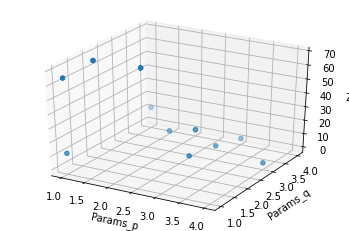

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Generate the data to plot
x = df['Params_p']
y = df['Params_q']
z = df['Test_error']-df['Train_error']

# Create a 3D plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x, y, z)

# Set the axis labels
ax.set_xlabel('Params_p')
ax.set_ylabel('Params_q')
ax.set_zlabel('Z')

# Show the plot
plt.show()




*   SARIMAX 



In [ ]:
train_data['date']=pd.to_datetime(train_data['date'],format='%Y%m%d %H:%M:%S')
df=pd.DataFrame({'Model_Name':[],'Farm_id':[],'Params_p':[],'Params_d':[],'Params_q':[],'Train_error':[],'Test_error':[]})
for i in range(0,4):
  df1=pd.DataFrame({'Model_Name':[],'Farm_id':[],'Params_p':[],'Params_d':[],'Params_q':[],'Train_error':[],'Test_error':[]})
  fid=random.choices(ing_z_st_list, k=1)
  fid=fid[0]
  data1=train_data[(train_data['farm_id']==fid)&(train_data['ingredient_type']=='ing_z')]
  data1=data1.groupby(by=['date','ingredient_type'],as_index=False).sum()
  data1_pivot=data1.pivot(index='date',columns='ingredient_type',values='yield')
  data1_pivot.columns.name=None
  new_date=pd.date_range('2016-01-01 00:00:00','2016-12-31 23:00:00',freq='H')
  data2=data1_pivot.reindex(new_date,fill_value=0)
  data2.fillna(0,inplace=True)
  ingw=data2[['ing_z']]
  train=ingw['2016-01':'2016-10']
  test=ingw['2016-11':'2016-12']
  for i in range(0,3):
    p=random.randint(1,4)
    q=random.randint(1,4)
    d=random.randint(1,2)
    model = sm.tsa.statespace.SARIMAX(train['ing_z'], order=(p,d,q), seasonal_order=(1, 1, 1, 6),initialization='approximate_diffuse').fit()
    train['predictions']=model.predict(start='2016-01-01 00:00:00',end='2016-10-31 23:00:00')
    test['predictions']=model.predict(start='2016-11-01 00:00:00',end='2016-12-31 23:00:00')
    tr_er=np.sqrt(mse(train['ing_z'],train['predictions']))
    te_er=np.sqrt(mse(test['ing_z'],test['predictions']))
    df1['Model_Name']=['ARIMA']
    df1['Farm_id']=[fid]
    df1['Params_p']=[p]
    df1['Params_d']=[d]
    df1['Params_q']=[q]
    df1['Train_error']=tr_er
    df1['Test_error']=te_er
  #new['Feedback']=feedback
  #df=pd.concat([df,new],axis=0)
  #model_name='Arma'
  #datafr=best_params_model('arma',fid,ingw,train,test,params)
  #datafr=best_params_model("ARMA",fid,ingw,train,test,params)
    df=pd.concat([df,df1],axis=0)
  


In [ ]:
df['Error']=df['Test_error']-df['Train_error']

In [ ]:
df.sort_values(by='Error',inplace=True)

In [ ]:
df

,Model_Name,Farm_id,Params_p,Params_d,Params_q,Train_error,Test_error,Error
0,ARMA,fid_78330,3.0,2.0,1.0,0.109978,0.373523,0.263545
0,ARMA,fid_78330,1.0,2.0,4.0,0.109772,0.389416,0.279644
0,ARMA,fid_78330,4.0,2.0,2.0,0.109923,0.406197,0.296274
0,ARMA,fid_78330,3.0,2.0,2.0,0.109962,0.433501,0.323539
0,ARMA,fid_78330,1.0,2.0,2.0,0.114799,0.499249,0.384450
0,ARMA,fid_78330,4.0,1.0,3.0,0.108824,0.564695,0.455870
0,ARMA,fid_78330,2.0,1.0,1.0,0.109238,0.585253,0.476015
0,ARMA,fid_78330,4.0,1.0,4.0,0.108633,0.616994,0.508361
0,ARMA,fid_64015,4.0,2.0,2.0,2.490549,6.550633,4.060084
0,ARMA,fid_64015,2.0,1.0,3.0,2.400612,6.772879,4.372267




*  For Plots



In [ ]:
#df=pd.DataFrame({'Model_Name':[],'Farm_id':[],'Params':[],'Train_error':[],'Test_error':[]})
def best_params_model(model_name,farm_id,data,train,test,params):
  #df=pd.DataFrame({'Model_Name':[],'Farm_id':[],'Params':[],'Train_error':[],'Test_error':[]})
  fig, axes = plt.subplots(2,2, figsize=(15, 8))
  fig.suptitle('Time series Plots')
  print("---------------Time_Series_Plots_For{}-------------".format(farm_id))
  #For data
  ax1=data.plot(ax=axes[0,0])
  ax1.set_title('data')
  #For acf
  ax1=sm.tsa.graphics.plot_acf(data,ax=axes[0,1],zero=False)
  #For pacf
  ax1=sm.tsa.graphics.plot_pacf(data,ax=axes[1,0],  zero = False)
  axes[1,1].set_axis_off() 
  plt.show()
  print('-------------------Prediction_plots_For{}-------------------'.format(farm_id))
  fig, axes = plt.subplots(2,2, figsize=(15, 8))
  fig.suptitle('Prediction_plots')
  #For train data
  ax1=train.plot(ax=axes[0,0])
  ax1.set_title('Train_data')
  #For test data
  ax1=test.plot(ax=axes[0,1])
  ax1.set_title('Test_data')
  tr_er=np.sqrt(mse(train['ing_w'],train['predictions']))
  te_er=np.sqrt(mse(test['ing_w'],test['predictions']))
  error=[tr_er,te_er]
  ##resid plot???
  x_axis=['Train_error','Test_error']
  sns.barplot(ax=axes[1,0],x=x_axis,y=error)
  axes[1,1].set_axis_off()
  plt.show()
  #a=input("Enter some description based on above plots")
  #new=pd.DataFrame()
  #df['Model_Name']=model_name
  #df['Farm_id']=farm_id
  #df['Params']=params
  #df['Train_error']=tr_er
  #df['Test_error']=te_er
  #new['Feedback']=feedback
  #df=pd.concat([df,new],axis=0)
  
  #return df



## Making paramters dataframe

In [ ]:
df=pd.DataFrame({'ingredient_type':[],'stationary type':[],'model_type':[],'parameters':[]})

In [ ]:
df['ingredient_type']=['ing_w','ing_w','ing_x','ing_x','ing_y','ing_y','ing_z','ing_z']
df['model_type']='SARIMAX'
df['stationary type']=['stationary','Non stationary','stationary','Non stationary','stationary','Non stationary','stationary','Non stationary']
df['parameters']=['(p,d,q)=(3,1,3)','(p,d,q)=(3,4,4)','(p,d,q)=(2,1,4)','(p,d,q)=(3,4,4)','(p,d,q)=(3,1,3)','(p,d,q)=(3,4,4)','(p,d,q)=(4,1,2)','(p,d,q)=(3,2,1)']


In [ ]:
df

,ingredient_type,stationary type,model_type,parameters
0,ing_w,stationary,SARIMAX,"(p,d,q)=(3,1,3)"
1,ing_w,Non stationary,SARIMAX,"(p,d,q)=(3,4,4)"
2,ing_x,stationary,SARIMAX,"(p,d,q)=(2,1,4)"
3,ing_x,Non stationary,SARIMAX,"(p,d,q)=(3,4,4)"
4,ing_y,stationary,SARIMAX,"(p,d,q)=(3,1,3)"
5,ing_y,Non stationary,SARIMAX,"(p,d,q)=(3,4,4)"
6,ing_z,stationary,SARIMAX,"(p,d,q)=(4,1,2)"
7,ing_z,Non stationary,SARIMAX,"(p,d,q)=(3,2,1)"


## For Finding optimum params


In [ ]:
x=df[['Params_p',	'Params_d','Params_q']]
x.shape
y=df['Test_error']-df['Train_error']

In [ ]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)


In [ ]:
regressor = RandomForestRegressor(n_estimators=100, max_depth=10, random_state=42)
regressor.fit(x_train,y_train)

RandomForestRegressor(max_depth=10, random_state=42)

In [ ]:
train_preds

array([ 23.65220299,  20.84756862,  19.89609658, 118.93602099,
        52.2463295 , 484.17530705,  93.85038606, 170.76387559,
       176.41661862,   7.9447807 ,  21.06533915, 424.73651662,
         7.29654588,  29.62921498, 199.6675215 ,  40.1111367 ,
        42.7607878 ,  91.10943009,  51.16853619,   7.9447807 ,
         7.29654588,  40.1111367 ])

In [ ]:
y_train

0      6.978053
0      9.522066
0      0.455870
0      0.296274
0      0.476015
0    636.958695
0    125.636391
0    207.880884
0    206.600203
0      9.562433
0      8.762110
0    620.253685
0      4.385985
0      4.573023
0     10.022166
0      4.372267
0      6.002599
0    109.030440
0      0.384450
0      0.508361
0      7.775044
0    106.943457
dtype: float64

In [ ]:
train_preds=regressor.predict(x_train)
test_preds=regressor.predict(x_test)

In [ ]:
y_test

0      0.263545
0      4.060084
0      0.279644
0     11.722927
0    109.030440
0      0.323539
dtype: float64

In [ ]:
test_preds

array([265.63244013, 118.93602099,  42.7607878 , 266.64120366,
        91.10943009, 176.41661862])

## SARIMA Forecast for 2017

1.   Model Running for batch 100
2.   List item



In [ ]:
len(ing_y_st_list)

300

In [ ]:
fid=ing_y_st_list[0:100]
len(fid)

100

In [ ]:
train_data=pd.read_csv('/content/drive/MyDrive/Final_capstone/train_data/train_data.csv')

In [ ]:
train_data['date']=pd.to_datetime(train_data['date'],format='%Y%m%d %H:%M:%S')

In [ ]:
%%time
df=pd.DataFrame({'date':[],'predictions':[],'farm_id':[],'ingredient_type':[]})
s=0
for i in fid:
  data1=train_data[train_data['farm_id']==i][['date','ingredient_type','yield']]
  #date conversion done above
  data1=data1.groupby(by=['date','ingredient_type'],as_index=False).sum()
  data1_pivot=data1.pivot(index='date',columns='ingredient_type',values='yield')
  data1_pivot.columns.name=None
  new_date=pd.date_range('2016-01-01 00:00:00','2016-12-31 23:00:00',freq='H')
  data2=data1_pivot.reindex(new_date,fill_value=0)
  data2.fillna(0,inplace=True)
  ingy=data2[['ing_y']]
  model = sm.tsa.statespace.SARIMAX(ingy, order=(3,1,4), seasonal_order=(1, 1, 1, 8),initialization='approximate_diffuse').fit()
  preds=model.predict(start='2017-01-01 00:00:00',end='2017-12-31 23:00:00')
  df1=preds.to_frame()
  df1['farm_id']=i
  df1.reset_index(inplace=True)
  df1.rename(columns={'index':'date','predicted_mean':'predictions'},inplace=True)
  df1['ingredient_type']='ing_y'
  df=pd.concat([df,df1],axis=0)
  s=s+1
  print("model {} successful".format(s))




model 1 successful
model 2 successful
model 3 successful
model 4 successful
model 5 successful
model 6 successful
model 7 successful
model 8 successful
model 9 successful
model 10 successful
model 11 successful
model 12 successful
model 13 successful
model 14 successful
model 15 successful
model 16 successful
model 17 successful
model 18 successful
model 19 successful
model 20 successful
model 21 successful
model 22 successful
model 23 successful
model 24 successful
model 25 successful
model 26 successful
model 27 successful
model 28 successful
model 29 successful
model 30 successful
model 31 successful
model 32 successful
model 33 successful
model 34 successful
model 35 successful
model 36 successful
model 37 successful
model 38 successful
model 39 successful
model 40 successful
model 41 successful
model 42 successful
model 43 successful
model 44 successful
model 45 successful
model 46 successful
model 47 successful
model 48 successful
model 49 successful
model 50 successful
model 51 

In [ ]:
 df

,date,predictions,farm_id,ingredient_type
0,2017-01-01 00:00:00,54.119342,fid_63700,ing_y
1,2017-01-01 01:00:00,57.542113,fid_63700,ing_y
2,2017-01-01 02:00:00,52.571918,fid_63700,ing_y
3,2017-01-01 03:00:00,51.281324,fid_63700,ing_y
4,2017-01-01 04:00:00,52.237634,fid_63700,ing_y
...,...,...,...,...
8755,2017-12-31 19:00:00,239.374251,fid_51284,ing_y
8756,2017-12-31 20:00:00,237.397279,fid_51284,ing_y
8757,2017-12-31 21:00:00,243.784860,fid_51284,ing_y
8758,2017-12-31 22:00:00,243.875725,fid_51284,ing_y


In [ ]:
df[df['predictions']<0]

,date,predictions,farm_id,ingredient_type
197,2017-01-09 05:00:00,-0.058046,fid_40771,ing_y
205,2017-01-09 13:00:00,-0.146759,fid_40771,ing_y
213,2017-01-09 21:00:00,-0.235472,fid_40771,ing_y
221,2017-01-10 05:00:00,-0.324185,fid_40771,ing_y
229,2017-01-10 13:00:00,-0.412898,fid_40771,ing_y
...,...,...,...,...
8755,2017-12-31 19:00:00,-3077.201929,fid_15805,ing_y
8756,2017-12-31 20:00:00,-3084.137428,fid_15805,ing_y
8757,2017-12-31 21:00:00,-3060.701861,fid_15805,ing_y
8758,2017-12-31 22:00:00,-2993.025073,fid_15805,ing_y


In [ ]:
df.to_csv("/content/drive/MyDrive/Final_capstone/Forecast_2017_Sarimax/ing_y_st/ing_y_st_negvals/1to100farmid.csv",index=False)

In [ ]:
df

,date,predictions,farm_id,ingredient_type
0,2017-01-01 00:00:00,54.119342,fid_63700,ing_y
1,2017-01-01 01:00:00,57.542113,fid_63700,ing_y
2,2017-01-01 02:00:00,52.571918,fid_63700,ing_y
3,2017-01-01 03:00:00,51.281324,fid_63700,ing_y
4,2017-01-01 04:00:00,52.237634,fid_63700,ing_y
...,...,...,...,...
8755,2017-12-31 19:00:00,239.374251,fid_51284,ing_y
8756,2017-12-31 20:00:00,237.397279,fid_51284,ing_y
8757,2017-12-31 21:00:00,243.784860,fid_51284,ing_y
8758,2017-12-31 22:00:00,243.875725,fid_51284,ing_y


In [ ]:
df1=df.copy()

In [ ]:
df1['predictions']=df1['predictions'].apply(lambda x: 0 if x<0 else x)
df1

,date,predictions,farm_id,ingredient_type
0,2017-01-01 00:00:00,54.119342,fid_63700,ing_y
1,2017-01-01 01:00:00,57.542113,fid_63700,ing_y
2,2017-01-01 02:00:00,52.571918,fid_63700,ing_y
3,2017-01-01 03:00:00,51.281324,fid_63700,ing_y
4,2017-01-01 04:00:00,52.237634,fid_63700,ing_y
...,...,...,...,...
8755,2017-12-31 19:00:00,239.374251,fid_51284,ing_y
8756,2017-12-31 20:00:00,237.397279,fid_51284,ing_y
8757,2017-12-31 21:00:00,243.784860,fid_51284,ing_y
8758,2017-12-31 22:00:00,243.875725,fid_51284,ing_y


In [ ]:
df1[df1['predictions']<0]

,date,predictions,farm_id,ingredient_type


In [ ]:
df1.to_csv("/content/drive/MyDrive/Final_capstone/Forecast_2017_Sarimax/ing_y_st/ing_y_st_noneg_Vals/1to100farmid.csv",index=False)

## Creating Submissions for Sarimax

In [ ]:
ing_w_st=pd.read_csv("/content/drive/MyDrive/Final_capstone/Forecast_2017_Sarimax/ing_w_st/ingw_total_preds.csv")
ing_x_st=pd.read_csv("/content/drive/MyDrive/Final_capstone/Forecast_2017_Sarimax/ing_x_st/ing_x__total.csv")
ing_y_st=pd.read_csv("/content/drive/MyDrive/Final_capstone/Forecast_2017_Sarimax/ing_y_st/ingy_total_preds.csv")
ing_z_st=pd.read_csv("/content/drive/MyDrive/Final_capstone/Forecast_2017_Sarimax/ing_z_st/ingz_total_preds.csv")
ing_all_ns=pd.read_csv("/content/drive/MyDrive/Final_capstone/Forecast_2017_Sarimax/ing_all_ns/allingwxyz_ns.csv")
ing_ns_all=ing_all_ns[['date','predictions','farm_id','ingredient_type']]
preds=pd.concat([ing_w_st,ing_x_st,ing_y_st,ing_z_st,ing_ns_all],axis=0)
preds_list=preds['farm_id'].value_counts().to_frame().reset_index()['index'].to_list()
test_data=pd.read_csv("/content/drive/MyDrive/Final_capstone/test_data/test_data-1664552867678.csv")
test_data.head()

In [ ]:
test_list=test_data['farm_id'].value_counts().to_frame().reset_index()['index'].to_list()

In [ ]:
total_merge=test_data.merge(preds,on=['date','farm_id','ingredient_type'])

In [ ]:
total_merge.shape

In [ ]:
total_merge.head()

In [ ]:
total_merge.sort_values(by='id',inplace=True)

In [ ]:
total_merge.head()

In [ ]:
sample_sub=pd.read_csv("/content/drive/MyDrive/Final_capstone/sample_submission-1646898326432-1664166963268.csv")
sample_sub.head()


In [ ]:
sub=total_merge[['id','predictions']]

In [ ]:
sub.rename(columns={'predictions':'yield'},inplace=True)

In [ ]:
sub.shape

In [ ]:
sub.to_csv("/content/drive/MyDrive/Final_capstone/Forecast_2017_Sarimax/4632_submission1.csv",index=False)

# Multivariate Analysis

# Approach-3


*   Multivariate analysis using StatsForecast



In [47]:
!pip install statsforecast
!pip install statsmodels

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [48]:
##Loading packages
from google.colab import drive
drive.mount('/content/drive')
from statsforecast.core import StatsForecast
from statsforecast.models import (ADIDA,CrostonClassic)
#from fbprophet import Prophet
#from fancyimpute import KNN

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [12]:
farm_data

,farm_id,operations_commencing_year,num_processing_plants,farm_area,farming_company,deidentified_location
0,fid_110884,2008.0,NaN,690.455096,Obery Farms,location 7369
1,fid_90053,2004.0,NaN,252.696160,Obery Farms,location 7369
2,fid_17537,1991.0,NaN,499.446528,Obery Farms,location 7369
3,fid_110392,2002.0,NaN,2200.407555,Obery Farms,location 7369
4,fid_62402,1975.0,NaN,10833.140121,Obery Farms,location 7369
...,...,...,...,...,...,...
1444,fid_41664,1914.0,NaN,1822.663957,Sanderson Farms,location 5150
1445,fid_14529,NaN,NaN,399.297094,Obery Farms,location 5150
1446,fid_46454,1997.0,NaN,1046.552295,Sanderson Farms,location 5150
1447,fid_24103,2001.0,NaN,2766.186825,Dole Food Company,location 5150


In [28]:
repe=farm_data['farm_id'].value_counts().to_frame().head(15).reset_index()['index'].to_list()

In [14]:
##15 farm_ids are repeated twice i.e farming company and deidentified_location are different

In [15]:
cols=total_data.columns.to_list()
df=pd.DataFrame(columns=cols)
for i in repe:
  df1=total_data[total_data['farm_id']==i]
  df=pd.concat([df,df1],axis=0)

In [16]:
df

,date,farm_id,ingredient_type,yield,deidentified_location,temp_obs,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed,farm_area,farming_company
749,2016-01-01 00:00:00,fid_29387,ing_w,0.1625,location 7048,1.9,200.0,-1.2,1016.2,-1.0,5.0,2590.971767,Wayne Farms
750,2016-01-01 00:00:00,fid_29387,ing_w,131.4450,location 7048,1.9,200.0,-1.2,1016.2,-1.0,5.0,2590.971767,Wayne Farms
2031,2016-01-01 01:00:00,fid_29387,ing_w,0.1525,location 5833,9.4,360.0,-2.2,1021.4,0.0,3.1,371.612000,Obery Farms
2032,2016-01-01 01:00:00,fid_29387,ing_w,0.1525,location 7048,1.6,190.0,-1.5,1016.3,0.0,3.0,2590.971767,Wayne Farms
2033,2016-01-01 01:00:00,fid_29387,ing_w,132.0550,location 5833,9.4,360.0,-2.2,1021.4,0.0,3.1,371.612000,Obery Farms
...,...,...,...,...,...,...,...,...,...,...,...,...,...
20509364,2016-12-31 23:00:00,fid_68761,ing_x,11.4649,location 5489,16.7,250.0,10.0,1011.0,0.0,2.6,3174.588413,Obery Farms
20509365,2016-12-31 23:00:00,fid_68761,ing_w,13.9300,location 5489,16.7,250.0,10.0,1011.0,0.0,2.6,2173.186976,Wayne Farms
20509366,2016-12-31 23:00:00,fid_68761,ing_w,13.9300,location 5489,16.7,250.0,10.0,1011.0,0.0,2.6,3174.588413,Obery Farms
20509367,2016-12-31 23:00:00,fid_68761,ing_z,5.8614,location 5489,16.7,250.0,10.0,1011.0,0.0,2.6,2173.186976,Wayne Farms


In [17]:
#total_data=train_data.merge(farm_wea,on=['farm_id','date'])

In [18]:
#total_data.to_csv("/content/drive/MyDrive/Final_capstone/train_data/total_data.csv",index=False)

In [19]:
total_data=pd.read_csv("/content/drive/MyDrive/Final_capstone/train_data/total_data.csv")
total_data.head()

,date,farm_id,ingredient_type,yield,deidentified_location,temp_obs,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed,farm_area,farming_company
0,2016-01-01 00:00:00,fid_110884,ing_w,0.0,location 7369,25.0,0.0,20.0,1019.7,0.0,0.0,690.455096,Obery Farms
1,2016-01-01 00:00:00,fid_90053,ing_w,0.0,location 7369,25.0,0.0,20.0,1019.7,0.0,0.0,252.696160,Obery Farms
2,2016-01-01 00:00:00,fid_17537,ing_w,0.0,location 7369,25.0,0.0,20.0,1019.7,0.0,0.0,499.446528,Obery Farms
3,2016-01-01 00:00:00,fid_110392,ing_w,0.0,location 7369,25.0,0.0,20.0,1019.7,0.0,0.0,2200.407555,Obery Farms
4,2016-01-01 00:00:00,fid_62402,ing_w,0.0,location 7369,25.0,0.0,20.0,1019.7,0.0,0.0,10833.140121,Obery Farms


In [20]:
total_data.shape

(20511532, 13)

In [21]:
total_data.isnull().sum()

date                     0
farm_id                  0
ingredient_type          0
yield                    0
deidentified_location    0
temp_obs                 0
wind_direction           0
dew_temp                 0
pressure_sea_level       0
precipitation            0
wind_speed               0
farm_area                0
farming_company          0
dtype: int64

### For ing_z

In [18]:
ingz=total_data[total_data['ingredient_type']=='ing_z']

In [19]:
ingz.shape

(1287747, 13)

In [20]:
ingz.head()

,date,farm_id,ingredient_type,yield,deidentified_location,temp_obs,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed,farm_area,farming_company
106,2016-01-01 00:00:00,fid_87942,ing_z,0.000,location 959,3.8,240.0,2.4,1020.9,-1.0,3.1,499.260722,Obery Farms
110,2016-01-01 00:00:00,fid_66870,ing_z,0.000,location 959,3.8,240.0,2.4,1020.9,-1.0,3.1,5295.006485,Obery Farms
114,2016-01-01 00:00:00,fid_66062,ing_z,96.978,location 959,3.8,240.0,2.4,1020.9,-1.0,3.1,2992.034018,Obery Farms
116,2016-01-01 00:00:00,fid_75323,ing_z,19.597,location 959,3.8,240.0,2.4,1020.9,-1.0,3.1,9334.986343,Obery Farms
118,2016-01-01 00:00:00,fid_75397,ing_z,100.000,location 959,3.8,240.0,2.4,1020.9,-1.0,3.1,12976.969749,Obery Farms


In [21]:
ingz.isnull().sum()

date                     0
farm_id                  0
ingredient_type          0
yield                    0
deidentified_location    0
temp_obs                 0
wind_direction           0
dew_temp                 0
pressure_sea_level       0
precipitation            0
wind_speed               0
farm_area                0
farming_company          0
dtype: int64

In [22]:
#ingz.drop(['deidentified_location','farming_company'],axis=1,inplace=True)

In [23]:
ingz.head()

,date,farm_id,ingredient_type,yield,deidentified_location,temp_obs,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed,farm_area,farming_company
106,2016-01-01 00:00:00,fid_87942,ing_z,0.000,location 959,3.8,240.0,2.4,1020.9,-1.0,3.1,499.260722,Obery Farms
110,2016-01-01 00:00:00,fid_66870,ing_z,0.000,location 959,3.8,240.0,2.4,1020.9,-1.0,3.1,5295.006485,Obery Farms
114,2016-01-01 00:00:00,fid_66062,ing_z,96.978,location 959,3.8,240.0,2.4,1020.9,-1.0,3.1,2992.034018,Obery Farms
116,2016-01-01 00:00:00,fid_75323,ing_z,19.597,location 959,3.8,240.0,2.4,1020.9,-1.0,3.1,9334.986343,Obery Farms
118,2016-01-01 00:00:00,fid_75397,ing_z,100.000,location 959,3.8,240.0,2.4,1020.9,-1.0,3.1,12976.969749,Obery Farms


In [24]:
ingz_farmid=ingz['farm_id'].value_counts().to_frame().reset_index()['index'].to_list()

In [25]:
ingz[ingz['farm_id']==ingz_farmid[0]]

,date,farm_id,ingredient_type,yield,deidentified_location,temp_obs,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed,farm_area,farming_company
455,2016-01-01 00:00:00,fid_73431,ing_z,0.0,location 5489,15.6,270.0,-5.6,1015.3,-1.0,3.6,3132.038839,Wayne Farms
456,2016-01-01 00:00:00,fid_73431,ing_z,0.0,location 2532,-8.3,250.0,-12.2,1023.3,-1.0,4.1,5630.479218,Obery Farms
1667,2016-01-01 01:00:00,fid_73431,ing_z,0.0,location 5489,13.9,270.0,-5.6,1015.6,0.0,4.1,3132.038839,Wayne Farms
1668,2016-01-01 01:00:00,fid_73431,ing_z,0.0,location 2532,-8.3,240.0,-11.7,1023.3,-1.0,4.1,5630.479218,Obery Farms
4005,2016-01-01 02:00:00,fid_73431,ing_z,0.0,location 5489,13.3,270.0,-5.6,1016.0,0.0,3.1,3132.038839,Wayne Farms
...,...,...,...,...,...,...,...,...,...,...,...,...,...
20504784,2016-12-31 21:00:00,fid_73431,ing_z,0.0,location 2532,-4.4,240.0,-11.7,1009.4,0.0,4.1,5630.479218,Obery Farms
20507193,2016-12-31 22:00:00,fid_73431,ing_z,0.0,location 5489,16.7,250.0,10.0,1011.0,0.0,3.6,3132.038839,Wayne Farms
20507194,2016-12-31 22:00:00,fid_73431,ing_z,0.0,location 2532,-5.0,230.0,-11.7,1010.0,0.0,4.6,5630.479218,Obery Farms
20509604,2016-12-31 23:00:00,fid_73431,ing_z,0.0,location 5489,16.7,250.0,10.0,1011.0,0.0,2.6,3132.038839,Wayne Farms


In [51]:
#To find paterner ship farms
repe

['fid_29387',
 'fid_68792',
 'fid_73431',
 'fid_40459',
 'fid_59158',
 'fid_81333',
 'fid_53126',
 'fid_26064',
 'fid_97094',
 'fid_63700',
 'fid_71910',
 'fid_18990',
 'fid_122174',
 'fid_54932',
 'fid_68761']

In [52]:
ingz_finalfid=[]
repe_ingz=[]
for i in ingz_farmid:
  if i in repe:
    repe_ingz.append(i)
  else:
    ingz_finalfid.append(i)


In [53]:
repe_ingz


['fid_73431', 'fid_68761', 'fid_63700']

In [54]:
len(ingz_finalfid)

142

In [55]:
ingz

,date,farm_id,ingredient_type,yield,deidentified_location,temp_obs,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed,farm_area,farming_company
106,2016-01-01 00:00:00,fid_87942,ing_z,0.000,location 959,3.8,240.0,2.4,1020.9,-1.0,3.1,499.260722,Obery Farms
110,2016-01-01 00:00:00,fid_66870,ing_z,0.000,location 959,3.8,240.0,2.4,1020.9,-1.0,3.1,5295.006485,Obery Farms
114,2016-01-01 00:00:00,fid_66062,ing_z,96.978,location 959,3.8,240.0,2.4,1020.9,-1.0,3.1,2992.034018,Obery Farms
116,2016-01-01 00:00:00,fid_75323,ing_z,19.597,location 959,3.8,240.0,2.4,1020.9,-1.0,3.1,9334.986343,Obery Farms
118,2016-01-01 00:00:00,fid_75397,ing_z,100.000,location 959,3.8,240.0,2.4,1020.9,-1.0,3.1,12976.969749,Obery Farms
...,...,...,...,...,...,...,...,...,...,...,...,...,...
20511280,2016-12-31 23:00:00,fid_113277,ing_z,2476.610,location 5410,6.1,190.0,-6.7,1012.4,-1.0,9.8,15467.327567,Sanderson Farms
20511283,2016-12-31 23:00:00,fid_46846,ing_z,1909.330,location 5410,6.1,190.0,-6.7,1012.4,-1.0,9.8,8101.141600,Wayne Farms
20511286,2016-12-31 23:00:00,fid_26870,ing_z,364.019,location 5410,6.1,190.0,-6.7,1012.4,-1.0,9.8,7867.769264,Sanderson Farms
20511288,2016-12-31 23:00:00,fid_75152,ing_z,156.050,location 5150,1.7,180.0,-5.6,1008.5,-1.0,8.8,14416.408831,Sanderson Farms


In [56]:
ingz.columns

Index(['date', 'farm_id', 'ingredient_type', 'yield', 'deidentified_location',
       'temp_obs', 'wind_direction', 'dew_temp', 'pressure_sea_level',
       'precipitation', 'wind_speed', 'farm_area', 'farming_company'],
      dtype='object')

In [57]:
len(ingz_finalfid)

142

In [58]:
#Preprocessing the data for statsforecast

In [59]:
ingz.isnull().sum()

date                     0
farm_id                  0
ingredient_type          0
yield                    0
deidentified_location    0
temp_obs                 0
wind_direction           0
dew_temp                 0
pressure_sea_level       0
precipitation            0
wind_speed               0
farm_area                0
farming_company          0
dtype: int64

In [60]:
ingz['date']=pd.to_datetime(ingz['date'])
cols=['farm_id', 'ingredient_type', 'yield', 'deidentified_location','temp_obs', 'wind_direction', 'dew_temp', 'pressure_sea_level','precipitation', 'wind_speed', 'farm_area', 'farming_company']
df=pd.DataFrame(columns=cols)
new_date=pd.date_range(start='2016-01-01 00:00:00',end='2016-12-31 23:00:00',freq='H')
for i in ingz_finalfid:
  a1=ingz[ingz['farm_id']==i]
  a1.set_index('date',inplace=True)
  a2=a1.reindex(new_date,fill_value=np.nan)
  a2['farm_id']=a2['farm_id'].fillna(i)
  fc=a2['farming_company'].value_counts().reset_index()['index'].to_list()
  a2['farming_company']=a2['farming_company'].fillna(fc[0])
  a2['yield']=a2['yield'].fillna(0)
  loc=a2['deidentified_location'].value_counts().reset_index()['index'].to_list()
  a2['deidentified_location']=a2['deidentified_location'].fillna(loc[0])
  a2['ingredient_type']=a2['ingredient_type'].fillna('ing_z')
  farm_area=a2['farm_area'].value_counts().reset_index()['index'].to_list()[0]
  a2['farm_area']=a2['farm_area'].fillna(farm_area)
  a2.interpolate(method='time',axis=0,inplace=True)
  df=pd.concat([df,a2],axis=0)
df.interpolate(method='time',axis=0,inplace=True)



In [61]:
df.isnull().sum()

farm_id                  0
ingredient_type          0
yield                    0
deidentified_location    0
temp_obs                 0
wind_direction           0
dew_temp                 0
pressure_sea_level       0
precipitation            0
wind_speed               0
farm_area                0
farming_company          0
dtype: int64

In [62]:
df.head()

,farm_id,ingredient_type,yield,deidentified_location,temp_obs,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed,farm_area,farming_company
2016-01-01 00:00:00,fid_34542,ing_z,20.5150,location 5489,15.6,270.0,-5.6,1015.3,-1.0,3.6,10371.226405,Obery Farms
2016-01-01 01:00:00,fid_34542,ing_z,17.5843,location 5489,13.9,270.0,-5.6,1015.6,0.0,4.1,10371.226405,Obery Farms
2016-01-01 02:00:00,fid_34542,ing_z,20.5150,location 5489,13.3,270.0,-5.6,1016.0,0.0,3.1,10371.226405,Obery Farms
2016-01-01 03:00:00,fid_34542,ing_z,20.5150,location 5489,12.2,280.0,-6.1,1016.6,0.0,3.1,10371.226405,Obery Farms
2016-01-01 04:00:00,fid_34542,ing_z,20.5150,location 5489,11.7,270.0,-6.7,1017.0,0.0,3.1,10371.226405,Obery Farms


In [63]:
df[df['farm_id']=='fid_27285']

,farm_id,ingredient_type,yield,deidentified_location,temp_obs,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed,farm_area,farming_company
2016-01-01 00:00:00,fid_27285,ing_z,0.000,location 1784,15.6,270.0,-5.6,1015.3,-1.0,3.6,7835.996438,Obery Farms
2016-01-01 01:00:00,fid_27285,ing_z,1303.400,location 1784,-10.6,0.0,-13.9,1036.7,0.0,0.0,7835.996438,Obery Farms
2016-01-01 02:00:00,fid_27285,ing_z,1531.180,location 1784,-11.1,0.0,-13.9,1036.9,0.0,0.0,7835.996438,Obery Farms
2016-01-01 03:00:00,fid_27285,ing_z,1436.850,location 1784,-10.0,280.0,-15.0,1036.9,0.0,2.6,7835.996438,Obery Farms
2016-01-01 04:00:00,fid_27285,ing_z,1479.420,location 1784,-13.3,230.0,-15.6,1037.8,0.0,1.5,7835.996438,Obery Farms
...,...,...,...,...,...,...,...,...,...,...,...,...
2016-12-31 19:00:00,fid_27285,ing_z,100.296,location 1784,-4.4,60.0,-7.2,1019.7,0.0,1.5,7835.996438,Obery Farms
2016-12-31 20:00:00,fid_27285,ing_z,89.550,location 1784,-4.4,170.0,-7.8,1018.8,0.0,2.1,7835.996438,Obery Farms
2016-12-31 21:00:00,fid_27285,ing_z,88.356,location 1784,-4.4,0.0,-7.2,1017.9,0.0,0.0,7835.996438,Obery Farms
2016-12-31 22:00:00,fid_27285,ing_z,96.714,location 1784,-4.4,120.0,-7.2,1017.8,0.0,2.1,7835.996438,Obery Farms


In [64]:
df.shape

(1247328, 12)

In [65]:
df.reset_index(inplace=True)

In [66]:
df.head()

,index,farm_id,ingredient_type,yield,deidentified_location,temp_obs,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed,farm_area,farming_company
0,2016-01-01 00:00:00,fid_34542,ing_z,20.5150,location 5489,15.6,270.0,-5.6,1015.3,-1.0,3.6,10371.226405,Obery Farms
1,2016-01-01 01:00:00,fid_34542,ing_z,17.5843,location 5489,13.9,270.0,-5.6,1015.6,0.0,4.1,10371.226405,Obery Farms
2,2016-01-01 02:00:00,fid_34542,ing_z,20.5150,location 5489,13.3,270.0,-5.6,1016.0,0.0,3.1,10371.226405,Obery Farms
3,2016-01-01 03:00:00,fid_34542,ing_z,20.5150,location 5489,12.2,280.0,-6.1,1016.6,0.0,3.1,10371.226405,Obery Farms
4,2016-01-01 04:00:00,fid_34542,ing_z,20.5150,location 5489,11.7,270.0,-6.7,1017.0,0.0,3.1,10371.226405,Obery Farms


In [67]:
df.rename(columns={'index':'ds','farm_id':'unique_id','yield':'y'},inplace=True)

In [68]:
df.head()

,ds,unique_id,ingredient_type,y,deidentified_location,temp_obs,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed,farm_area,farming_company
0,2016-01-01 00:00:00,fid_34542,ing_z,20.5150,location 5489,15.6,270.0,-5.6,1015.3,-1.0,3.6,10371.226405,Obery Farms
1,2016-01-01 01:00:00,fid_34542,ing_z,17.5843,location 5489,13.9,270.0,-5.6,1015.6,0.0,4.1,10371.226405,Obery Farms
2,2016-01-01 02:00:00,fid_34542,ing_z,20.5150,location 5489,13.3,270.0,-5.6,1016.0,0.0,3.1,10371.226405,Obery Farms
3,2016-01-01 03:00:00,fid_34542,ing_z,20.5150,location 5489,12.2,280.0,-6.1,1016.6,0.0,3.1,10371.226405,Obery Farms
4,2016-01-01 04:00:00,fid_34542,ing_z,20.5150,location 5489,11.7,270.0,-6.7,1017.0,0.0,3.1,10371.226405,Obery Farms


In [69]:
y=df[['y','unique_id','ds']]

In [ ]:
StatsForecast.plot(y)

In [ ]:
df.columns

Index(['ds', 'unique_id', 'ingredient_type', 'y', 'deidentified_location',
       'temp_obs', 'wind_direction', 'dew_temp', 'pressure_sea_level',
       'precipitation', 'wind_speed', 'farm_area', 'farming_company'],
      dtype='object')

In [ ]:
x=df[['ds', 'unique_id','temp_obs', 'wind_direction', 'dew_temp', 'pressure_sea_level','precipitation', 'wind_speed', 'farm_area']]

In [ ]:
StatsForecast.plot(x)

In [ ]:
dates=y['ds'].unique()

In [ ]:
dtrain=dates[:-744]
dtest=dates[-744:]

In [ ]:
y_train=y.query('ds in @dtrain')
y_test=y.query('ds in @dtest')

In [ ]:
len(dtest)

744

In [ ]:
x_train=x.query('ds in @dtrain')
x_test=x.query('ds in @dtest')

In [ ]:
train=y_train.merge(x_train,on=['unique_id','ds'])

In [ ]:
train.isnull().sum()

y                     0
unique_id             0
ds                    0
temp_obs              0
wind_direction        0
dew_temp              0
pressure_sea_level    0
precipitation         0
wind_speed            0
farm_area             0
dtype: int64

In [ ]:
test=y_test.merge(x_test,on=['unique_id','ds'])

In [ ]:
test.isnull().sum()

y                     0
unique_id             0
ds                    0
temp_obs              0
wind_direction        0
dew_temp              0
pressure_sea_level    0
precipitation         0
wind_speed            0
farm_area             0
dtype: int64

In [ ]:
x_test

,ds,unique_id,temp_obs,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed,farm_area
8040,2016-12-01 00:00:00,fid_34542,15.6,310.0,-7.8,1014.3,0.0,2.1,10371.226405
8041,2016-12-01 01:00:00,fid_34542,15.0,320.0,-8.3,1014.1,0.0,3.1,10371.226405
8042,2016-12-01 02:00:00,fid_34542,14.4,310.0,-7.2,1014.1,0.0,2.6,10371.226405
8043,2016-12-01 03:00:00,fid_34542,10.6,230.0,-1.7,1014.3,0.0,2.1,10371.226405
8044,2016-12-01 04:00:00,fid_34542,10.0,230.0,-1.1,1014.4,0.0,3.1,10371.226405
...,...,...,...,...,...,...,...,...,...
1247323,2016-12-31 19:00:00,fid_40781,6.7,200.0,-8.3,1015.8,0.0,6.7,25384.258302
1247324,2016-12-31 20:00:00,fid_40781,5.6,200.0,-6.7,1015.3,0.0,5.7,25384.258302
1247325,2016-12-31 21:00:00,fid_40781,5.6,190.0,-6.7,1014.9,0.0,5.7,25384.258302
1247326,2016-12-31 22:00:00,fid_40781,5.6,190.0,-6.7,1014.0,0.0,6.7,25384.258302


In [ ]:
from statsforecast.models import(AutoETS,CrostonClassic)

In [ ]:
models=[AutoETS(season_length=3),CrostonClassic()]

In [ ]:
fore=StatsForecast(models=models,freq='H',verbose=True)

In [ ]:
fore.fit(df=train)

StatsForecast(models=[AutoETS,CrostonClassic])

In [ ]:
preds=fore.predict(h=744,X_df=x_test,level=[95])

In [ ]:
preds.reset_index(inplace=True)

In [ ]:
preds.head()

,unique_id,ds,AutoETS,AutoETS-lo-95,AutoETS-hi-95,CrostonClassic
0,fid_100952,2016-12-01 00:00:00,73.135651,-56.009846,202.281143,79.455124
1,fid_100952,2016-12-01 01:00:00,73.135651,-57.533672,203.804962,79.455124
2,fid_100952,2016-12-01 02:00:00,73.135651,-59.039928,205.311234,79.455124
3,fid_100952,2016-12-01 03:00:00,73.135651,-60.529217,206.800522,79.455124
4,fid_100952,2016-12-01 04:00:00,73.135651,-62.002090,208.273392,79.455124


In [ ]:
StatsForecast.plot(preds,y_test)

In [ ]:
preds

,unique_id,ds,AutoETS,AutoETS-lo-95,AutoETS-hi-95,CrostonClassic
0,fid_100952,2016-12-01 00:00:00,73.135651,-56.009846,202.281143,79.455124
1,fid_100952,2016-12-01 01:00:00,73.135651,-57.533672,203.804962,79.455124
2,fid_100952,2016-12-01 02:00:00,73.135651,-59.039928,205.311234,79.455124
3,fid_100952,2016-12-01 03:00:00,73.135651,-60.529217,206.800522,79.455124
4,fid_100952,2016-12-01 04:00:00,73.135651,-62.002090,208.273392,79.455124
...,...,...,...,...,...,...
105643,fid_99942,2016-12-31 19:00:00,0.084114,-449.871979,450.040222,0.256737
105644,fid_99942,2016-12-31 20:00:00,0.000275,-450.259155,450.259705,0.256737
105645,fid_99942,2016-12-31 21:00:00,0.122278,-450.440277,450.684814,0.256737
105646,fid_99942,2016-12-31 22:00:00,0.084114,-450.781342,450.949585,0.256737


In [ ]:
for_rmse=test.merge(preds,on=['ds','unique_id'])

In [ ]:
from sklearn.metrics import mean_squared_error as mse
def rmse(data):
  c=np.sqrt(mse(data['y'],data['CrostonClassic']))
  print("CrostonClassic:",c)
  autoets=np.sqrt(mse(data['y'],data['AutoETS']))
  print('AutoETS',autoets)

In [ ]:
rmse(for_rmse)


CrostonClassic: 3052.7500787846448
AutoETS 3593.400319969731


<AxesSubplot:>

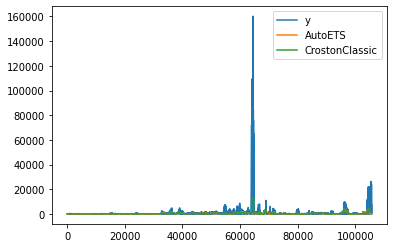

In [ ]:
for_rmse[['y','AutoETS','CrostonClassic']].plot()

## Forecasting ing_z for 2017

In [45]:
#ingz_test_data_preparation

In [9]:
total_test=pd.read_csv("/content/drive/MyDrive/Final_capstone/test_data/test_merged.csv")

In [11]:
#ingw
ingw=len(total_test[total_test['ingredient_type']=='ing_w']['farm_id'].value_counts().to_frame().reset_index())
#ingx
ingx=len(total_test[total_test['ingredient_type']=='ing_x']['farm_id'].value_counts().to_frame().reset_index())
#ingy
ingy=len(total_test[total_test['ingredient_type']=='ing_y']['farm_id'].value_counts().to_frame().reset_index())
#ingz
ingz=len(total_test[total_test['ingredient_type']=='ing_z']['farm_id'].value_counts().to_frame().reset_index())

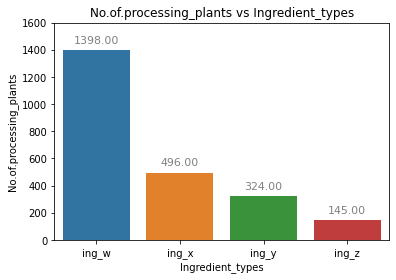

In [12]:
x=['ing_w','ing_x','ing_y','ing_z']
y=[ingw,ingx,ingy,ingz]
ax = sns.barplot(x=x,y=y)
#ax.set_xticklabels(ax.get_xticklabels(),rotation=)
for p in ax.patches:
    ax.annotate("%.2f" % p.get_height(), (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', fontsize=11, color='gray', xytext=(0, 10),textcoords='offset points')

ax.set_xlabel("Ingredient_types")
ax.set_ylabel("No.of.processing_plants")
ax.set_title("No.of.processing_plants vs Ingredient_types")
plt.ylim(0, 1600)
plt.show()

In [13]:
total_test['date']=pd.to_datetime(total_test['date'])

In [14]:
ing_z_test=total_test[total_test['ingredient_type']=='ing_z']

In [15]:
len(ing_z_test)

1291548

In [29]:
ingz_test=ing_z_test['farm_id'].value_counts().to_frame().reset_index()['index'].to_list()
ingz_finalfid_test=[]
repe_ingz_test=[]
for i in ingz_test:
  if i in repe:
    repe_ingz_test.append(i)
  else:
    ingz_finalfid_test.append(i)


In [30]:
len(ingz_test)

145

In [31]:
len(ingz_finalfid_test)

142

In [32]:
ing_z_test.reset_index(inplace=True)

In [33]:
ing_z_test.columns

Index(['index', 'date', 'farm_id', 'ingredient_type', 'id',
       'deidentified_location', 'temp_obs', 'wind_direction', 'dew_temp',
       'pressure_sea_level', 'precipitation', 'wind_speed', 'farm_area',
       'farming_company'],
      dtype='object')

In [34]:
ing_z_test['date']=pd.to_datetime(ing_z_test['date'])
cols=['farm_id', 'ingredient_type', 'id', 'deidentified_location', 'temp_obs','wind_direction', 'dew_temp', 'pressure_sea_level', 'precipitation','wind_speed', 'farm_area', 'farming_company']
df_test=pd.DataFrame(columns=cols)
new_date=pd.date_range(start='2017-01-01 00:00:00',end='2017-12-31 23:00:00',freq='H')
for i in ingz_finalfid_test:
  a1=ing_z_test[ing_z_test['farm_id']==i]
  a1.set_index('date',inplace=True)
  a2=a1.reindex(new_date,fill_value=np.nan)
  a2['farm_id']=a2['farm_id'].fillna(i)
  fc=a2['farming_company'].value_counts().reset_index()['index'].to_list()
  a2['farming_company']=a2['farming_company'].fillna(fc[0])
  #a2['yield']=a2['yield'].fillna(0)
  loc=a2['deidentified_location'].value_counts().reset_index()['index'].to_list()
  a2['deidentified_location']=a2['deidentified_location'].fillna(loc[0])
  a2['ingredient_type']=a2['ingredient_type'].fillna('ing_z')
  farm_area=a2['farm_area'].value_counts().reset_index()['index'].to_list()[0]
  a2['farm_area']=a2['farm_area'].fillna(farm_area)
  a2.interpolate(method='time',axis=0,inplace=True)
  df_test=pd.concat([df_test,a2],axis=0)
df_test.interpolate(method='time',axis=0,inplace=True)



In [35]:
df_test.head()

,farm_id,ingredient_type,id,deidentified_location,temp_obs,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed,farm_area,farming_company,index
2017-01-01 00:00:00,fid_53696,ing_z,3349401,location 5489,16.1,310.0,9.4,1010.6,5.0,2.1,8145.084719,Obery Farms,1707975.0
2017-01-01 01:00:00,fid_53696,ing_z,3349690,location 5489,16.1,0.0,10.0,1010.5,0.0,0.0,8145.084719,Obery Farms,1708274.0
2017-01-01 02:00:00,fid_53696,ing_z,3349979,location 5489,15.6,0.0,11.1,1010.8,0.0,0.0,8145.084719,Obery Farms,1708573.0
2017-01-01 03:00:00,fid_53696,ing_z,3350268,location 5489,15.6,80.0,10.0,1010.9,0.0,2.6,8145.084719,Obery Farms,1708872.0
2017-01-01 04:00:00,fid_53696,ing_z,3350557,location 5489,14.4,110.0,11.1,1010.7,0.0,2.1,8145.084719,Obery Farms,1709171.0


In [36]:
df_test.isnull().sum()

farm_id                   0
ingredient_type           0
id                       69
deidentified_location     0
temp_obs                  0
wind_direction            0
dew_temp                  0
pressure_sea_level        0
precipitation             0
wind_speed                0
farm_area                 0
farming_company           0
index                     0
dtype: int64

In [37]:
df_test.reset_index(inplace=True)

In [38]:
df_test.head()

,level_0,farm_id,ingredient_type,id,deidentified_location,temp_obs,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed,farm_area,farming_company,index
0,2017-01-01 00:00:00,fid_53696,ing_z,3349401,location 5489,16.1,310.0,9.4,1010.6,5.0,2.1,8145.084719,Obery Farms,1707975.0
1,2017-01-01 01:00:00,fid_53696,ing_z,3349690,location 5489,16.1,0.0,10.0,1010.5,0.0,0.0,8145.084719,Obery Farms,1708274.0
2,2017-01-01 02:00:00,fid_53696,ing_z,3349979,location 5489,15.6,0.0,11.1,1010.8,0.0,0.0,8145.084719,Obery Farms,1708573.0
3,2017-01-01 03:00:00,fid_53696,ing_z,3350268,location 5489,15.6,80.0,10.0,1010.9,0.0,2.6,8145.084719,Obery Farms,1708872.0
4,2017-01-01 04:00:00,fid_53696,ing_z,3350557,location 5489,14.4,110.0,11.1,1010.7,0.0,2.1,8145.084719,Obery Farms,1709171.0


In [39]:
df_test.rename(columns={'level_0':'ds','farm_id':'unique_id'},inplace=True)

In [40]:
df_test.head()

,ds,unique_id,ingredient_type,id,deidentified_location,temp_obs,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed,farm_area,farming_company,index
0,2017-01-01 00:00:00,fid_53696,ing_z,3349401,location 5489,16.1,310.0,9.4,1010.6,5.0,2.1,8145.084719,Obery Farms,1707975.0
1,2017-01-01 01:00:00,fid_53696,ing_z,3349690,location 5489,16.1,0.0,10.0,1010.5,0.0,0.0,8145.084719,Obery Farms,1708274.0
2,2017-01-01 02:00:00,fid_53696,ing_z,3349979,location 5489,15.6,0.0,11.1,1010.8,0.0,0.0,8145.084719,Obery Farms,1708573.0
3,2017-01-01 03:00:00,fid_53696,ing_z,3350268,location 5489,15.6,80.0,10.0,1010.9,0.0,2.6,8145.084719,Obery Farms,1708872.0
4,2017-01-01 04:00:00,fid_53696,ing_z,3350557,location 5489,14.4,110.0,11.1,1010.7,0.0,2.1,8145.084719,Obery Farms,1709171.0


In [41]:
x_test=df_test[['ds', 'unique_id','temp_obs', 'wind_direction', 'dew_temp', 'pressure_sea_level','precipitation', 'wind_speed', 'farm_area']]

In [42]:
x_test.head()

,ds,unique_id,temp_obs,wind_direction,dew_temp,pressure_sea_level,precipitation,wind_speed,farm_area
0,2017-01-01 00:00:00,fid_53696,16.1,310.0,9.4,1010.6,5.0,2.1,8145.084719
1,2017-01-01 01:00:00,fid_53696,16.1,0.0,10.0,1010.5,0.0,0.0,8145.084719
2,2017-01-01 02:00:00,fid_53696,15.6,0.0,11.1,1010.8,0.0,0.0,8145.084719
3,2017-01-01 03:00:00,fid_53696,15.6,80.0,10.0,1010.9,0.0,2.6,8145.084719
4,2017-01-01 04:00:00,fid_53696,14.4,110.0,11.1,1010.7,0.0,2.1,8145.084719


In [43]:
x_test.dtypes

ds                    datetime64[ns]
unique_id                     object
temp_obs                     float64
wind_direction               float64
dew_temp                     float64
pressure_sea_level           float64
precipitation                float64
wind_speed                   float64
farm_area                    float64
dtype: object

In [44]:
x_test.isnull().sum()

ds                    0
unique_id             0
temp_obs              0
wind_direction        0
dew_temp              0
pressure_sea_level    0
precipitation         0
wind_speed            0
farm_area             0
dtype: int64

In [45]:
x_test.shape

(1243920, 9)

In [49]:
from statsforecast.models import(AutoETS,CrostonClassic)
models=[AutoETS(season_length=3),CrostonClassic()]
fore=StatsForecast(models=models,freq='H',verbose=True)

In [70]:
x=df[['ds', 'unique_id','temp_obs', 'wind_direction', 'dew_temp', 'pressure_sea_level','precipitation', 'wind_speed', 'farm_area']]

In [71]:
x.isnull().sum()

ds                    0
unique_id             0
temp_obs              0
wind_direction        0
dew_temp              0
pressure_sea_level    0
precipitation         0
wind_speed            0
farm_area             0
dtype: int64

In [72]:
y.isnull().sum()

y            0
unique_id    0
ds           0
dtype: int64

In [73]:
ingz_train=y.merge(x,on=['unique_id','ds'])

In [74]:
ingz_train.shape

(1247328, 10)

In [75]:
fore.fit(df=ingz_train)

StatsForecast(models=[AutoETS,CrostonClassic])

In [76]:
test_preds=fore.predict(h=8760,X_df=x_test,level=[95])

In [78]:
test_preds.to_csv("/content/drive/MyDrive/Final_capstone/test_data/ingz_future_mulvar.csv",index=False)

In [79]:
StatsForecast.plot(test_preds)

In [80]:
test_preds

,ds,AutoETS,AutoETS-lo-95,AutoETS-hi-95,CrostonClassic
unique_id,,,,,
fid_100952,2017-01-01 00:00:00,191.225662,58.986374,323.464935,206.025208
fid_100952,2017-01-01 01:00:00,191.225662,56.843742,325.607574,206.025208
fid_100952,2017-01-01 02:00:00,191.225662,54.734737,327.716583,206.025208
fid_100952,2017-01-01 03:00:00,191.225662,52.657833,329.793488,206.025208
fid_100952,2017-01-01 04:00:00,191.225662,50.611599,331.839722,206.025208
...,...,...,...,...,...
fid_99942,2017-12-31 19:00:00,11.965178,-1556.688599,1580.619019,66.646164
fid_99942,2017-12-31 20:00:00,11.628136,-1557.115112,1580.371338,66.646164
fid_99942,2017-12-31 21:00:00,11.860031,-1556.972534,1580.692627,66.646164


In [81]:
ingz_graph=test_preds.groupby(by='ds',as_index=False).sum()

In [84]:
ingz_graph['unique_id']=1

In [87]:
StatsForecast.plot(ingz_graph)

In [90]:
ingz_graph.set_index('ds',inplace=True)

In [91]:
ingz_graph

,AutoETS,AutoETS-lo-95,AutoETS-hi-95,CrostonClassic,unique_id
ds,,,,,
2017-01-01 00:00:00,108814.367188,2.394661e+04,1.936821e+05,84324.789062,1
2017-01-01 01:00:00,108675.656250,1.311539e+04,2.042359e+05,84324.789062,1
2017-01-01 02:00:00,108496.210938,4.041834e+03,2.129506e+05,84324.789062,1
2017-01-01 03:00:00,108812.609375,-3.458918e+03,2.210841e+05,84324.789062,1
2017-01-01 04:00:00,108674.484375,-1.067161e+04,2.280206e+05,84324.789062,1
...,...,...,...,...,...
2017-12-31 19:00:00,111178.789062,-3.385939e+06,3.608297e+06,84324.789062,1
2017-12-31 20:00:00,111000.203125,-3.386323e+06,3.608324e+06,84324.789062,1
2017-12-31 21:00:00,111317.257812,-3.386212e+06,3.608846e+06,84324.789062,1


In [96]:
ingz_graph.reset_index(inplace=True)

In [97]:
ingz_graph

,ds,AutoETS,AutoETS-lo-95,AutoETS-hi-95,CrostonClassic,unique_id
0,2017-01-01 00:00:00,108814.367188,2.394661e+04,1.936821e+05,84324.789062,1
1,2017-01-01 01:00:00,108675.656250,1.311539e+04,2.042359e+05,84324.789062,1
2,2017-01-01 02:00:00,108496.210938,4.041834e+03,2.129506e+05,84324.789062,1
3,2017-01-01 03:00:00,108812.609375,-3.458918e+03,2.210841e+05,84324.789062,1
4,2017-01-01 04:00:00,108674.484375,-1.067161e+04,2.280206e+05,84324.789062,1
...,...,...,...,...,...,...
8755,2017-12-31 19:00:00,111178.789062,-3.385939e+06,3.608297e+06,84324.789062,1
8756,2017-12-31 20:00:00,111000.203125,-3.386323e+06,3.608324e+06,84324.789062,1
8757,2017-12-31 21:00:00,111317.257812,-3.386212e+06,3.608846e+06,84324.789062,1
8758,2017-12-31 22:00:00,111179.648438,-3.386554e+06,3.608914e+06,84324.789062,1


In [98]:
ingz_graph['ds']=pd.to_datetime(ingz_graph['ds'])

In [99]:
ingz_graph.set_index('ds',inplace=True)

In [ ]:
ingz_graph

<AxesSubplot:xlabel='ds'>

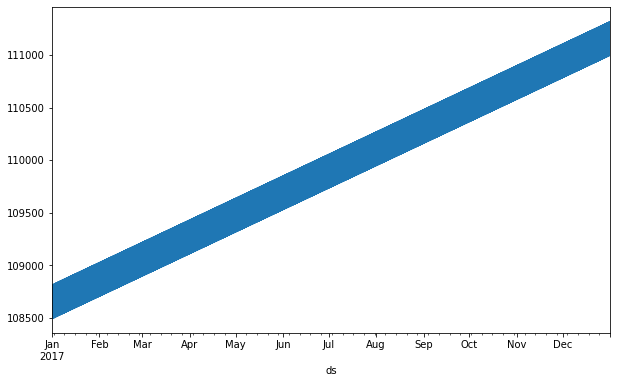

In [105]:
ingz_graph['AutoETS'].plot(figsize=(10,6))

### For ing_w

In [ ]:
ingw=total_data[total_data['ingredient_type']=='ing_w']

In [ ]:
ingw.shape

(12269895, 13)

In [ ]:
ingw_farmid=ingw['farm_id'].value_counts().to_frame().reset_index()['index'].to_list()

In [ ]:
len(ingw_farmid)

1398

In [ ]:
ingw_finalfid=[]
repe_ingw=[]
for i in ingw_farmid:
  if i in repe:
    repe_ingw.append(i)
  else:
    ingw_finalfid.append(i)


In [ ]:
len(ingw_finalfid)

1383

In [ ]:
ingw['date']=pd.to_datetime(ingw['date'])
cols=['farm_id', 'ingredient_type', 'yield', 'deidentified_location','temp_obs', 'wind_direction', 'dew_temp', 'pressure_sea_level','precipitation', 'wind_speed', 'farm_area', 'farming_company']
df=pd.DataFrame(columns=cols)
new_date=pd.date_range(start='2016-01-01 00:00:00',end='2016-12-31 23:00:00',freq='H')
for i in ingw_finalfid:
  a1=ingw[ingw['farm_id']==i]
  a1.set_index('date',inplace=True)
  a2=a1.reindex(new_date,fill_value=np.nan)
  a2['farm_id']=a2['farm_id'].fillna(i)
  fc=a2['farming_company'].value_counts().reset_index()['index'].to_list()
  a2['farming_company']=a2['farming_company'].fillna(fc[0])
  a2['yield']=a2['yield'].fillna(0)
  loc=a2['deidentified_location'].value_counts().reset_index()['index'].to_list()
  a2['deidentified_location']=a2['deidentified_location'].fillna(loc[0])
  a2['ingredient_type']=a2['ingredient_type'].fillna('ing_z')
  farm_area=a2['farm_area'].value_counts().reset_index()['index'].to_list()[0]
  a2['farm_area']=a2['farm_area'].fillna(farm_area)
  a2.interpolate(method='time',axis=0,inplace=True)
  df=pd.concat([df,a2],axis=0)
df.interpolate(method='time',axis=0,inplace=True)



In [ ]:
1383*8784

In [ ]:
df.shape

(12148272, 12)

In [ ]:
df.to_csv("/content/drive/MyDrive/Final_capstone/train_data/demand_ingw.csv",index=False)

#